<a href="https://colab.research.google.com/github/djordje34/PY-Notebooks/blob/main/keras_fsl_unet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import array_to_img
from PIL import Image, ImageOps
import tensorflow as tf
from keras.models import Model
from tqdm import tqdm

In [ ]:
def dice_coefficient(mask1, mask2, smooth=1e-5):
    intersection = np.logical_and(mask1, mask2)
    dice = (2.0 * np.sum(intersection) + smooth) / (np.sum(mask1) + np.sum(mask2) + smooth)
    return dice

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


SRC = '/content/drive/MyDrive/datasets/lung2/whole_lung/'
SRC2 = '/content/drive/MyDrive/datasets/lung2/zoomed/'

IMGS = SRC + 'square/'
MASKS = SRC + 'masks/'

TESTIMGS = SRC2 + 'imgs2/'
TESTMASKS = SRC2 + 'msks2/'

INPUT = (1024,1024)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
def load_and_preprocess_data(img_dir, mask_dir, input_shape, dir=1):
    images = []
    masks = []
    print(img_dir)
    img_files = sorted(os.listdir(img_dir),key = lambda x:int(x.split('.')[0]))
    mask_files = sorted(os.listdir(mask_dir),key = lambda x:int(x.split('.')[0])) #INT je vrlo bitan jer ako ga nema poredi kao string i onda 577 >> 1005 npr. XD

    for mask_file in mask_files:
        if dir == 1:
            mask = Image.open(os.path.join(mask_dir, mask_file)).convert('L')
            img = Image.open(os.path.join(img_dir, mask_file.split('.')[0]+".png")).convert('L') #OVDE VRATI NA .tif SA .png KAD TRENIRAS ili proveravas!

            img = np.array(img.resize(input_shape, resample=Image.NEAREST), dtype=np.float32) / 255.0
            mask = np.array(mask.resize(input_shape, resample=Image.NEAREST), dtype=np.float32) / 255.0

            mask[mask >= 0.5] = 1.0
            mask[mask < 0.5] = 0.0
        else:
            bgc = (91)
            mask = Image.open(os.path.join(mask_dir, mask_file)).convert('L')
            img = Image.open(os.path.join(img_dir, mask_file.split('.')[0] + ".png")).convert('L')

            target_height, target_width = input_shape
            current_height, current_width = np.shape(img)
            border_height = max(0, target_height - current_height)
            border_width = max(0, target_width - current_width)

            padding_top = border_height // 2
            padding_bottom = border_height - padding_top
            padding_left = border_width // 2
            padding_right = border_width - padding_left

            img_with_padding = ImageOps.expand(img, border=(padding_left, padding_top, padding_right, padding_bottom), fill=bgc)
            mask_with_padding = ImageOps.expand(mask, border=(padding_left, padding_top, padding_right, padding_bottom), fill=bgc)

            img = np.array(img_with_padding.convert('L'), dtype=np.float32) / 255.0
            mask = np.array(mask_with_padding.convert('L'), dtype=np.float32) / 255.0

            mask[mask >= 0.5] = 1.0
            mask[mask < 0.5] = 0.0

        images.append(img)
        masks.append(mask)

    del img_files
    del mask_files

    return np.array(images), np.array(masks)

In [ ]:
import numpy as np

def load_test_data(img_dir, input_shape, dir=1):
    images = []
    masks = []
    img_files = sorted(os.listdir(img_dir),key = lambda x:int(x.split('.')[0]))
    img_files = img_files[40:65]
    for img_file in img_files:
        if dir == 1:
            img = Image.open(os.path.join(img_dir, img_file)).convert('L') #OVDE VRATI NA .tif SA .png KAD TRENIRAS!

            img = np.array(img.resize(input_shape, resample=Image.NEAREST), dtype=np.float32) / 255.0
        else:
            bgc = (91)
            img = Image.open(os.path.join(img_dir, img_file)).convert('L')

            target_height, target_width = input_shape
            current_height, current_width = np.shape(img)
            border_height = max(0, target_height - current_height)
            border_width = max(0, target_width - current_width)

            padding_top = border_height // 2
            padding_bottom = border_height - padding_top
            padding_left = border_width // 2
            padding_right = border_width - padding_left
            img_with_padding = ImageOps.expand(img, border=(padding_left, padding_top, padding_right, padding_bottom), fill=bgc)
            img = np.array(img_with_padding.convert('L'), dtype=np.float32) / 255.0
        images.append(img)
    del img_files

    return np.array(images)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

def create_data_generator(imgs, masks, input_shape, batch_size=2):
    datagen = ImageDataGenerator(
        rotation_range=20,
        width_shift_range=0.2,
        height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest'
    )

    image_generator = datagen.flow(imgs, batch_size=batch_size, seed=42)
    mask_generator = datagen.flow(masks, batch_size=batch_size, seed=42)

    return zip(image_generator, mask_generator)

In [ ]:
def plot_image(image, mask, title=""):
    image = np.expand_dims(image, axis=-1)
    image = array_to_img(image)
    mask = np.expand_dims(mask, axis=-1)
    mask = array_to_img(mask)

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    axes[0].imshow(image, cmap="gray")
    axes[0].set_title("Image")
    axes[1].imshow(mask, cmap="gray")
    axes[1].set_title(f"Mask ({title})")

    for ax in axes:
        ax.axis("off")
    plt.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

/content/drive/MyDrive/datasets/lung2/whole_lung/square/
(17, 1024, 1024) (17, 1024, 1024)


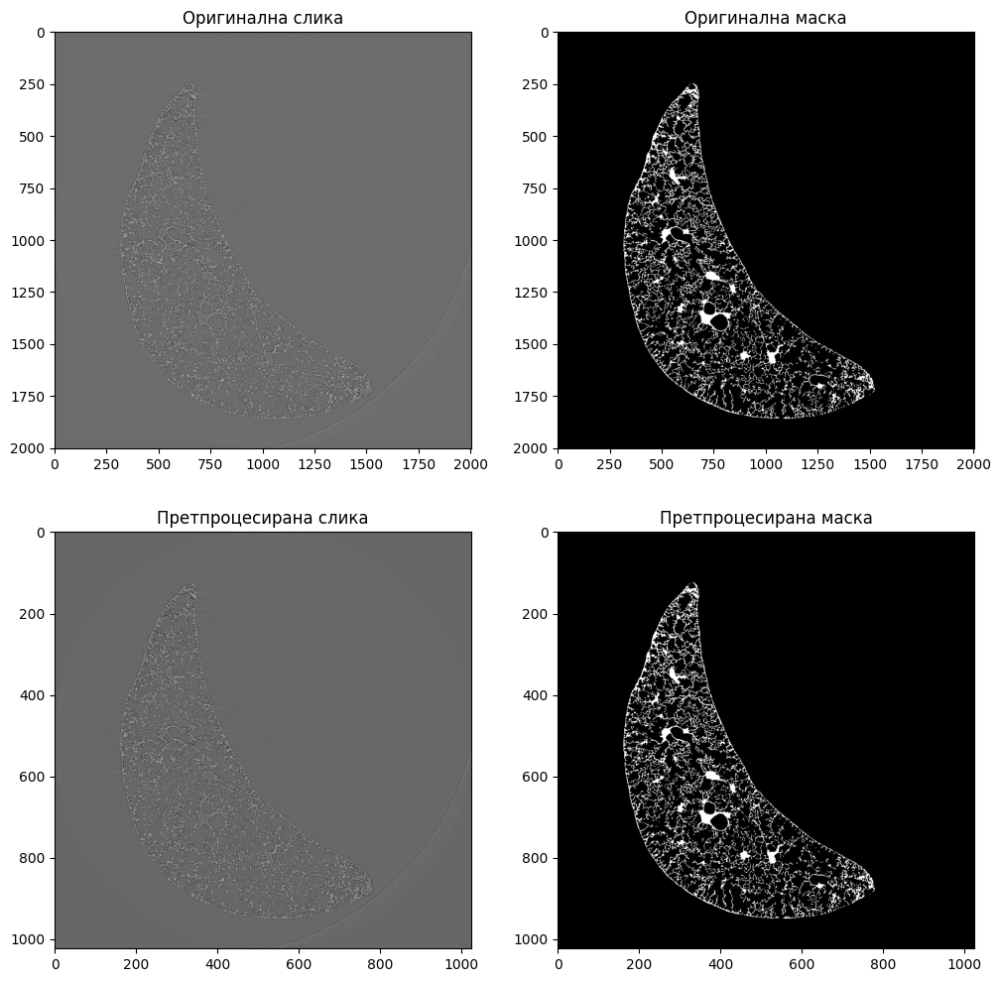

In [ ]:
images, masks = load_and_preprocess_data(IMGS, MASKS, INPUT)
images = images.astype(np.float32)
masks = masks.astype(np.float32)
test_images = load_test_data(IMGS, INPUT)
test_images = test_images.astype(np.float32)
print(np.shape(images), np.shape(masks))
#for i in range(len(images)):
  #plot_image(images[i], masks[i], title=f"pr{i}")

original_img_path = os.path.join(IMGS, sorted(os.listdir(MASKS), key=lambda x: int(x.split('.')[0]))[10])
original_mask_path = os.path.join(MASKS, sorted(os.listdir(MASKS), key=lambda x: int(x.split('.')[0]))[10])

original_img = Image.open(original_img_path.split('.')[0]+".tif")

#original_img = Image.open(original_img_path).convert('L')
original_mask = Image.open(original_mask_path)

preprocessed_img = images[10]
preprocessed_mask = masks[10]

fig, axs = plt.subplots(2, 2, figsize=(12, 12))

axs[0, 0].imshow(original_img, cmap='gray')
axs[0, 0].set_title('Оригинална слика')

axs[0, 1].imshow(original_mask, cmap='gray')
axs[0, 1].set_title('Оригинална маска')

axs[1, 0].imshow(preprocessed_img, cmap='gray')
axs[1, 0].set_title('Претпроцесирана слика')

axs[1, 1].imshow(preprocessed_mask, cmap='gray')
axs[1, 1].set_title('Претпроцесирана маска')

plt.show()


In [ ]:
from keras.layers import Conv2D,BatchNormalization, Dropout, MaxPooling2D, concatenate, Conv2DTranspose, Input
def create_unet_model(input_shape):
    inputs = Input(input_shape)

    #Encoder
    c1 = Conv2D(32, 3, activation='relu', padding='same')(inputs)
    #c1 = BatchNormalization()(c1)
    c1 = Dropout(0.3)(c1)
    c1 = Conv2D(32, 3, activation='relu', padding='same')(c1)
    #c1 = BatchNormalization()(c1)
    p1 = MaxPooling2D(2)(c1)

    c2 = Conv2D(64, 3, activation='relu', padding='same')(p1)
    #c2 = BatchNormalization()(c2)
    c2 = Dropout(0.3)(c2)
    c2 = Conv2D(64, 3, activation='relu', padding='same')(c2)
    #c2 = BatchNormalization()(c2)
    p2 = MaxPooling2D(2)(c2)

    c3 = Conv2D(128, 3, activation='relu', padding='same')(p2)
    #c3 = BatchNormalization()(c3)
    c3 = Dropout(0.3)(c3)
    c3 = Conv2D(128, 3, activation='relu', padding='same')(c3)
    #c3 = BatchNormalization()(c3)
    p3 = MaxPooling2D(2)(c3)

    c4 = Conv2D(256, 3, activation='relu', padding='same')(p3)
    #c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    c4 = Conv2D(256, 3, activation='relu', padding='same')(c4)
    #c4 = BatchNormalization()(c4)
    p4 = MaxPooling2D(2)(c4)

    #Bottleneck
    b = Conv2D(512, 3, activation='relu', padding='same')(p4)
    b = Conv2D(512, 3, activation='relu', padding='same')(b)
    #b = BatchNormalization()(b)
    b = Dropout(0.3)(b)

    #Decoder
    u4 = Conv2DTranspose(256, 3, strides=2, activation='relu', padding='same')(b)
    u4 = concatenate([u4, c4])
    #u4 = BatchNormalization()(u4)

    c4 = Conv2D(256, 3, activation='relu', padding='same')(u4)
    #c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    c4 = Conv2D(256, 3, activation='relu', padding='same')(c4)
    #c4 = BatchNormalization()(c4)

    u3 = Conv2DTranspose(128, 3, strides=2, activation='relu', padding='same')(c4)
    u3 = concatenate([u3, c3])
    #u3 = BatchNormalization()(u3)

    c3 = Conv2D(128, 3, activation='relu', padding='same')(u3)
    #c3 = BatchNormalization()(c3)
    c3 = Dropout(0.3)(c3)
    c3 = Conv2D(128, 3, activation='relu', padding='same')(c3)
    #c3 = BatchNormalization()(c3)

    u2 = Conv2DTranspose(64, 3, strides=2, activation='relu', padding='same')(c3)
    u2 = concatenate([u2, c2])
    #u2 = BatchNormalization()(u2)

    c2 = Conv2D(64, 3, activation='relu', padding='same')(u2)
    #c2 = BatchNormalization()(c2)
    c2 = Dropout(0.3)(c2)
    c2 = Conv2D(64, 3, activation='relu', padding='same')(c2)
    #c2 = BatchNormalization()(c2)

    u1 = Conv2DTranspose(32, 3, strides=2, activation='relu', padding='same')(c2)
    u1 = concatenate([u1, c1])
    #u1 = BatchNormalization()(u1)

    c1 = Conv2D(32, 3, activation='relu', padding='same')(u1)
    #c1 = BatchNormalization()(c1)
    c1 = Dropout(0.3)(c1)
    c1 = Conv2D(32, 3, activation='relu', padding='same')(c1)
    #c1 = BatchNormalization()(c1)

    outputs = Conv2D(1, 1, activation='sigmoid')(c1)
    model = Model(inputs=inputs, outputs=outputs)

    return model


def create_simpler_unet_model(input_shape):
    inputs = Input(input_shape)
    #Encoder
    c1 = Conv2D(16, 3, activation='relu', padding='same')(inputs)
    #c1 = BatchNormalization()(c1)
    c1 = Dropout(0.3)(c1)
    c1 = Conv2D(16, 3, activation='relu', padding='same')(c1)
    #c1 = BatchNormalization()(c1)
    p1 = MaxPooling2D(2)(c1)

    c2 = Conv2D(32, 3, activation='relu', padding='same')(p1)
    #c2 = BatchNormalization()(c2)
    c2 = Dropout(0.3)(c2)
    c2 = Conv2D(32, 3, activation='relu', padding='same')(c2)
    #c2 = BatchNormalization()(c2)
    p2 = MaxPooling2D(2)(c2)

    c3 = Conv2D(64, 3, activation='relu', padding='same')(p2)
    #c3 = BatchNormalization()(c3)
    c3 = Dropout(0.3)(c3)
    c3 = Conv2D(64, 3, activation='relu', padding='same')(c3)
    #c3 = BatchNormalization()(c3)
    p3 = MaxPooling2D(2)(c3)

    c4 = Conv2D(128, 3, activation='relu', padding='same')(p3)
    #c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    c4 = Conv2D(128, 3, activation='relu', padding='same')(c4)
    #c4 = BatchNormalization()(c4)
    p4 = MaxPooling2D(2)(c4)

    #Bottleneck
    b = Conv2D(256, 3, activation='relu', padding='same')(p4)
    b = Conv2D(256, 3, activation='relu', padding='same')(b)
    #b = BatchNormalization()(b)
    b = Dropout(0.3)(b)

    #Decoder
    u4 = Conv2DTranspose(128, 3, strides=2, activation='relu', padding='same')(b)
    u4 = concatenate([u4, c4])
    u4 = BatchNormalization()(u4)

    c4 = Conv2D(128, 3, activation='relu', padding='same')(u4)
    c4 = BatchNormalization()(c4)
    c4 = Dropout(0.3)(c4)
    c4 = Conv2D(128, 3, activation='relu', padding='same')(c4)
    c4 = BatchNormalization()(c4)

    u3 = Conv2DTranspose(64, 3, strides=2, activation='relu', padding='same')(c4)
    u3 = concatenate([u3, c3])
    u3 = BatchNormalization()(u3)

    c3 = Conv2D(64, 3, activation='relu', padding='same')(u3)
    c3 = BatchNormalization()(c3)
    c3 = Dropout(0.3)(c3)
    c3 = Conv2D(64, 3, activation='relu', padding='same')(c3)
    c3 = BatchNormalization()(c3)

    u2 = Conv2DTranspose(32, 3, strides=2, activation='relu', padding='same')(c3)
    u2 = concatenate([u2, c2])
    u2 = BatchNormalization()(u2)

    c2 = Conv2D(32, 3, activation='relu', padding='same')(u2)
    c2 = BatchNormalization()(c2)
    c2 = Dropout(0.3)(c2)
    c2 = Conv2D(32, 3, activation='relu', padding='same')(c2)
    c2 = BatchNormalization()(c2)

    u1 = Conv2DTranspose(16, 3, strides=2, activation='relu', padding='same')(c2)
    u1 = concatenate([u1, c1])
    u1 = BatchNormalization()(u1)

    c1 = Conv2D(16, 3, activation='relu', padding='same')(u1)
    c1 = BatchNormalization()(c1)
    c1 = Dropout(0.3)(c1)
    c1 = Conv2D(16, 3, activation='relu', padding='same')(c1)
    c1 = BatchNormalization()(c1)

    outputs = Conv2D(1, 1, activation='sigmoid')(c1)
    model = Model(inputs=inputs, outputs=outputs)

    return model

In [ ]:
#custom ep gen
import numpy as np
import tensorflow as tf
from sklearn.model_selection import train_test_split


def create_episode(images, masks,selected_samples, min_query_samples=1, input_shape=(1024, 1024,1)):
    """
    Create an episode for binary semantic segmentation with U-Net.

    Parameters:
    - images: List of grayscale input images.
    - masks: List of corresponding binary masks.
    - min_query_samples: Minimum number of samples to include in the query set for each class.
    - input_shape: Input shape for the U-Net model.
    - seed: Seed for random number generator.

    Returns:
    - support_images: Input data (images) for the support set.
    - support_masks: Target data (masks) for the support set.
    - query_images: Input data (images) for the query set.
    - query_masks: Target data (masks) for the query set.
    """

    support_images = []
    support_masks = []
    query_images = []
    query_masks = []

    for sample_index in selected_samples:
        support_images.append(images[sample_index])
        support_masks.append(masks[sample_index])

    query_samples = list(set(range(len(images))) - set(selected_samples))
    query_samples = np.random.choice(query_samples, size = min_query_samples, replace = False)

    for sample_index in query_samples:
      query_images.append(images[sample_index])
      query_masks.append(masks[sample_index])

    del selected_samples, query_samples


    support_images = np.array(support_images, dtype=np.float32)
    support_masks = np.array(support_masks, dtype=np.float32)
    support_masks = np.expand_dims(support_masks, axis = -1)


    query_images = np.array(query_images, dtype = np.float32)
    query_masks = np.array(query_masks, dtype=np.float32)
    query_masks = np.expand_dims(query_masks, axis = -1)

    return support_images, support_masks, query_images, query_masks

In [ ]:
import tensorflow.keras.mixed_precision as mixed_precision

gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)



In [ ]:
def get_split_eff(imgs,masks,size=0.2,which=True):
    if which:
        r1, t1, r2, t2 = train_test_split(imgs, masks, test_size=size, shuffle=False)
    else:
        t1, r1, t2, r2 = train_test_split(imgs, masks, test_size=size, shuffle=False)

    del t1, t2

    return r1,r2

In [ ]:
from sklearn.model_selection import train_test_split

val_images, train_images, val_masks,train_masks = train_test_split(images, masks, test_size=0.7, shuffle=False)

In [ ]:
from tqdm import tqdm
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint


#reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.0001, verbose=1)
#early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1)


model = create_unet_model((INPUT[0],INPUT[1], 1))

best_loss = float('inf')
best_epoch = -1
num_epochs = 100
num_episodes_per_epoch = 10

val_images, train_images, val_masks,train_masks = train_test_split(images, masks, test_size=0.7, shuffle=False)

np.random.seed(42)
#selected_samples = np.random.choice(range(len(train_images)), 5, replace = False)
selected_samples = list(range(len(train_images)))[-5:] #pet najvecih slika - 5-Shot
print(selected_samples)


support_images = []
support_masks = []
query_images = []
query_masks = []
for sample_index in selected_samples:
    support_images.append(train_images[sample_index])
    support_masks.append(train_masks[sample_index])


query_samples = list(set(range(len(train_images))) - set(selected_samples))
query_samples = np.random.choice(query_samples, size = 5, replace = False)

for sample_index in query_samples:
    query_images.append(images[sample_index])
    query_masks.append(masks[sample_index])

#Each episode is the same, to respect the rules of 5-Shot FSL
support_images = np.array(support_images, dtype=np.float32)
support_masks = np.array(support_masks, dtype=np.float32)

support_masks = np.expand_dims(support_masks, axis = -1)

query_images = np.array(query_images, dtype = np.float32)
query_masks = np.array(query_masks, dtype=np.float32)

#query_masks = np.expand_dims(query_masks, axis = -1)

support_images = tf.expand_dims(support_images, axis=-1)
query_images = tf.expand_dims(query_images, axis=-1)

print(np.shape(support_images),np.shape(support_masks),np.shape(query_images),np.shape(query_masks))

del images
del masks
del selected_samples, query_samples

optimizer = tf.keras.optimizers.Adam(learning_rate=0.001) #probaj sa ovim lr
loss_fn = tf.keras.losses.BinaryCrossentropy()

model.compile(optimizer=optimizer, loss=loss_fn)

optimization_tape = tf.GradientTape()

@tf.function(reduce_retracing=True)
def optimize_step(model, images, masks):
    with optimization_tape as tape:
        predictions = model(images, training=True)
        predictions = tf.squeeze(predictions, axis=-1)
        loss = loss_fn(masks, predictions)

        del predictions

    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))

    del gradients
    return loss

for epoch in range(num_epochs):
    epoch_support_loss = 0.0
    epoch_query_loss = 0.0
    val_support_loss = 0.0

    pbar = tqdm(range(num_episodes_per_epoch), desc=f"Epoch {epoch+1}/{num_epochs}\tSupport Loss: {epoch_support_loss / num_episodes_per_epoch:.4f}", unit="eps")

    for j in pbar:
        support_loss = optimize_step(model, support_images, support_masks)
        epoch_support_loss += support_loss

        del support_loss

        query_predictions = model(query_images)
        query_predictions = tf.squeeze(query_predictions, axis=-1)

        query_loss = loss_fn(query_masks, query_predictions)
        epoch_query_loss += query_loss

        del query_loss

        pbar.set_description(f"Epoch {epoch+1}/{num_epochs}\tSupport Loss: {epoch_support_loss / (j+1):.4f}\tQuery Loss: {epoch_query_loss / (j+1):.4f}")

    del pbar
    current_val_loss = epoch_query_loss / num_episodes_per_epoch
    if current_val_loss < best_loss:
        best_loss = current_val_loss
        best_epoch = epoch
        model.save(f"model_chck.keras")
        print(f"Saved model: Epoch: {epoch + 1} Query Loss: {current_val_loss}")

[7, 8, 9, 10, 11]
(5, 1024, 1024, 1) (5, 1024, 1024, 1) (5, 1024, 1024, 1) (5, 1024, 1024)


Epoch 1/100	Support Loss: 0.4892	Query Loss: 0.4109: 100%|██████████| 10/10 [01:57<00:00, 11.75s/eps]


Saved model: Epoch: 1 Query Loss: 0.41086357831954956


Epoch 2/100	Support Loss: 0.2267	Query Loss: 0.2073: 100%|██████████| 10/10 [00:29<00:00,  2.95s/eps]


Saved model: Epoch: 2 Query Loss: 0.20733699202537537


Epoch 3/100	Support Loss: 0.2139	Query Loss: 0.1919: 100%|██████████| 10/10 [00:29<00:00,  2.96s/eps]


Saved model: Epoch: 3 Query Loss: 0.19189287722110748


Epoch 4/100	Support Loss: 0.2089	Query Loss: 0.1859: 100%|██████████| 10/10 [00:29<00:00,  2.95s/eps]


Saved model: Epoch: 4 Query Loss: 0.18587224185466766


Epoch 5/100	Support Loss: 0.2007	Query Loss: 0.1756: 100%|██████████| 10/10 [00:29<00:00,  2.94s/eps]


Saved model: Epoch: 5 Query Loss: 0.17561694979667664


Epoch 6/100	Support Loss: 0.1814	Query Loss: 0.1540: 100%|██████████| 10/10 [00:29<00:00,  2.95s/eps]


Saved model: Epoch: 6 Query Loss: 0.1539681851863861


Epoch 7/100	Support Loss: 0.1332	Query Loss: 0.1306: 100%|██████████| 10/10 [00:29<00:00,  2.95s/eps]


Saved model: Epoch: 7 Query Loss: 0.13063092529773712


Epoch 8/100	Support Loss: 0.1083	Query Loss: 0.1388: 100%|██████████| 10/10 [00:29<00:00,  2.95s/eps]
Epoch 9/100	Support Loss: 0.1047	Query Loss: 0.1596: 100%|██████████| 10/10 [00:29<00:00,  2.94s/eps]
Epoch 10/100	Support Loss: 0.1016	Query Loss: 0.1621: 100%|██████████| 10/10 [00:29<00:00,  2.94s/eps]
Epoch 11/100	Support Loss: 0.0994	Query Loss: 0.1543: 100%|██████████| 10/10 [00:29<00:00,  2.94s/eps]
Epoch 12/100	Support Loss: 0.0970	Query Loss: 0.1680: 100%|██████████| 10/10 [00:29<00:00,  2.93s/eps]
Epoch 13/100	Support Loss: 0.1162	Query Loss: 0.1362: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]
Epoch 14/100	Support Loss: 0.1010	Query Loss: 0.1220: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]


Saved model: Epoch: 14 Query Loss: 0.12204448133707047


Epoch 15/100	Support Loss: 0.0988	Query Loss: 0.1111: 100%|██████████| 10/10 [00:29<00:00,  2.92s/eps]


Saved model: Epoch: 15 Query Loss: 0.11107835918664932


Epoch 16/100	Support Loss: 0.0949	Query Loss: 0.0994: 100%|██████████| 10/10 [00:29<00:00,  2.92s/eps]


Saved model: Epoch: 16 Query Loss: 0.09940899908542633


Epoch 17/100	Support Loss: 0.0920	Query Loss: 0.0928: 100%|██████████| 10/10 [00:29<00:00,  2.92s/eps]


Saved model: Epoch: 17 Query Loss: 0.09275850653648376


Epoch 18/100	Support Loss: 0.0892	Query Loss: 0.0973: 100%|██████████| 10/10 [00:29<00:00,  2.92s/eps]
Epoch 19/100	Support Loss: 0.0855	Query Loss: 0.1029: 100%|██████████| 10/10 [00:29<00:00,  2.93s/eps]
Epoch 20/100	Support Loss: 0.0798	Query Loss: 0.1096: 100%|██████████| 10/10 [00:29<00:00,  2.92s/eps]
Epoch 21/100	Support Loss: 0.0743	Query Loss: 0.1105: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 22/100	Support Loss: 0.0693	Query Loss: 0.1159: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 23/100	Support Loss: 0.2940	Query Loss: 0.2598: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 24/100	Support Loss: 0.1614	Query Loss: 0.1299: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 25/100	Support Loss: 0.1497	Query Loss: 0.1226: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]
Epoch 26/100	Support Loss: 0.1318	Query Loss: 0.1072: 100%|██████████| 10/10 [00:29<00:00,  2.90s/eps]
Epoch 27/100	Support Loss: 0.1026	Query Loss: 0.0802: 100%|██████████| 10

Saved model: Epoch: 27 Query Loss: 0.08024227619171143


Epoch 28/100	Support Loss: 0.0853	Query Loss: 0.0677: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 28 Query Loss: 0.0676797404885292


Epoch 29/100	Support Loss: 0.0771	Query Loss: 0.0610: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 29 Query Loss: 0.06101221591234207


Epoch 30/100	Support Loss: 0.0750	Query Loss: 0.0592: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 30 Query Loss: 0.0592062845826149


Epoch 31/100	Support Loss: 0.0730	Query Loss: 0.0578: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]


Saved model: Epoch: 31 Query Loss: 0.05778045579791069


Epoch 32/100	Support Loss: 0.0711	Query Loss: 0.0558: 100%|██████████| 10/10 [00:29<00:00,  2.90s/eps]


Saved model: Epoch: 32 Query Loss: 0.055751461535692215


Epoch 33/100	Support Loss: 0.0692	Query Loss: 0.0530: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]


Saved model: Epoch: 33 Query Loss: 0.052992742508649826


Epoch 34/100	Support Loss: 0.0671	Query Loss: 0.0508: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]


Saved model: Epoch: 34 Query Loss: 0.05075492709875107


Epoch 35/100	Support Loss: 0.0652	Query Loss: 0.0489: 100%|██████████| 10/10 [00:29<00:00,  2.91s/eps]


Saved model: Epoch: 35 Query Loss: 0.04894038662314415


Epoch 36/100	Support Loss: 0.0632	Query Loss: 0.0475: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]


Saved model: Epoch: 36 Query Loss: 0.047515399754047394


Epoch 37/100	Support Loss: 0.0616	Query Loss: 0.0463: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]


Saved model: Epoch: 37 Query Loss: 0.04629457741975784


Epoch 38/100	Support Loss: 0.0604	Query Loss: 0.0454: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 38 Query Loss: 0.045430734753608704


Epoch 39/100	Support Loss: 0.0596	Query Loss: 0.0452: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 39 Query Loss: 0.04519832879304886


Epoch 40/100	Support Loss: 0.0583	Query Loss: 0.0439: 100%|██████████| 10/10 [00:28<00:00,  2.88s/eps]


Saved model: Epoch: 40 Query Loss: 0.04389699548482895


Epoch 41/100	Support Loss: 0.0610	Query Loss: 0.0463: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 42/100	Support Loss: 0.0617	Query Loss: 0.0479: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 43/100	Support Loss: 0.0624	Query Loss: 0.0486: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]
Epoch 44/100	Support Loss: 0.0597	Query Loss: 0.0455: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]
Epoch 45/100	Support Loss: 0.0584	Query Loss: 0.0440: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]
Epoch 46/100	Support Loss: 0.0573	Query Loss: 0.0435: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]


Saved model: Epoch: 46 Query Loss: 0.04347014054656029


Epoch 47/100	Support Loss: 0.0563	Query Loss: 0.0425: 100%|██████████| 10/10 [00:28<00:00,  2.87s/eps]


Saved model: Epoch: 47 Query Loss: 0.04249773919582367


Epoch 48/100	Support Loss: 0.0549	Query Loss: 0.0411: 100%|██████████| 10/10 [00:28<00:00,  2.87s/eps]


Saved model: Epoch: 48 Query Loss: 0.04108100011944771


Epoch 49/100	Support Loss: 0.0552	Query Loss: 0.0414: 100%|██████████| 10/10 [00:28<00:00,  2.87s/eps]
Epoch 50/100	Support Loss: 0.0551	Query Loss: 0.0421: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 51/100	Support Loss: 0.0527	Query Loss: 0.0396: 100%|██████████| 10/10 [00:28<00:00,  2.88s/eps]


Saved model: Epoch: 51 Query Loss: 0.03955143690109253


Epoch 52/100	Support Loss: 0.0581	Query Loss: 0.0489: 100%|██████████| 10/10 [00:28<00:00,  2.90s/eps]
Epoch 53/100	Support Loss: 0.0551	Query Loss: 0.0409: 100%|██████████| 10/10 [00:28<00:00,  2.89s/eps]
Epoch 54/100	Support Loss: 0.0529	Query Loss: 0.0395: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]


Saved model: Epoch: 54 Query Loss: 0.0394974909722805


Epoch 55/100	Support Loss: 0.0510	Query Loss: 0.0386: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 55 Query Loss: 0.03856387734413147


Epoch 56/100	Support Loss: 0.0567	Query Loss: 0.0421: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]
Epoch 57/100	Support Loss: 0.0553	Query Loss: 0.0416: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]
Epoch 58/100	Support Loss: 0.0552	Query Loss: 0.0415: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]
Epoch 59/100	Support Loss: 0.0551	Query Loss: 0.0410: 100%|██████████| 10/10 [00:28<00:00,  2.87s/eps]
Epoch 60/100	Support Loss: 0.0538	Query Loss: 0.0403: 100%|██████████| 10/10 [00:28<00:00,  2.82s/eps]
Epoch 61/100	Support Loss: 0.0529	Query Loss: 0.0395: 100%|██████████| 10/10 [00:28<00:00,  2.82s/eps]
Epoch 62/100	Support Loss: 0.0518	Query Loss: 0.0389: 100%|██████████| 10/10 [00:28<00:00,  2.82s/eps]
Epoch 63/100	Support Loss: 0.0510	Query Loss: 0.0387: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]
Epoch 64/100	Support Loss: 0.0488	Query Loss: 0.0375: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]


Saved model: Epoch: 64 Query Loss: 0.03753306344151497


Epoch 65/100	Support Loss: 0.0521	Query Loss: 0.0401: 100%|██████████| 10/10 [00:28<00:00,  2.87s/eps]
Epoch 66/100	Support Loss: 0.0486	Query Loss: 0.0366: 100%|██████████| 10/10 [00:28<00:00,  2.86s/eps]


Saved model: Epoch: 66 Query Loss: 0.03659771755337715


Epoch 67/100	Support Loss: 0.0453	Query Loss: 0.0338: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]


Saved model: Epoch: 67 Query Loss: 0.033778972923755646


Epoch 68/100	Support Loss: 0.0435	Query Loss: 0.0337: 100%|██████████| 10/10 [00:28<00:00,  2.82s/eps]


Saved model: Epoch: 68 Query Loss: 0.03367367759346962


Epoch 69/100	Support Loss: 0.0424	Query Loss: 0.0334: 100%|██████████| 10/10 [00:28<00:00,  2.82s/eps]


Saved model: Epoch: 69 Query Loss: 0.03335438296198845


Epoch 70/100	Support Loss: 0.0439	Query Loss: 0.0383: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]
Epoch 71/100	Support Loss: 0.0539	Query Loss: 0.0391: 100%|██████████| 10/10 [00:28<00:00,  2.86s/eps]
Epoch 72/100	Support Loss: 0.0529	Query Loss: 0.0393: 100%|██████████| 10/10 [00:28<00:00,  2.86s/eps]
Epoch 73/100	Support Loss: 0.0511	Query Loss: 0.0388: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]
Epoch 74/100	Support Loss: 0.0497	Query Loss: 0.0416: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]
Epoch 75/100	Support Loss: 0.0474	Query Loss: 0.0364: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]
Epoch 76/100	Support Loss: 0.0460	Query Loss: 0.0357: 100%|██████████| 10/10 [00:28<00:00,  2.86s/eps]
Epoch 77/100	Support Loss: 0.0442	Query Loss: 0.0337: 100%|██████████| 10/10 [00:28<00:00,  2.86s/eps]
Epoch 78/100	Support Loss: 0.0413	Query Loss: 0.0319: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]


Saved model: Epoch: 78 Query Loss: 0.03188910335302353


Epoch 79/100	Support Loss: 0.0400	Query Loss: 0.0313: 100%|██████████| 10/10 [00:28<00:00,  2.85s/eps]


Saved model: Epoch: 79 Query Loss: 0.03127463534474373


Epoch 80/100	Support Loss: 0.0394	Query Loss: 0.0307: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 80 Query Loss: 0.03074023500084877


Epoch 81/100	Support Loss: 0.0388	Query Loss: 0.0306: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 81 Query Loss: 0.030597278848290443


Epoch 82/100	Support Loss: 0.0385	Query Loss: 0.0301: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]


Saved model: Epoch: 82 Query Loss: 0.030147721990942955


Epoch 83/100	Support Loss: 0.0381	Query Loss: 0.0299: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]


Saved model: Epoch: 83 Query Loss: 0.02992885373532772


Epoch 84/100	Support Loss: 0.0377	Query Loss: 0.0296: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]


Saved model: Epoch: 84 Query Loss: 0.029598543420433998


Epoch 85/100	Support Loss: 0.0375	Query Loss: 0.0292: 100%|██████████| 10/10 [00:28<00:00,  2.83s/eps]


Saved model: Epoch: 85 Query Loss: 0.029150620102882385


Epoch 86/100	Support Loss: 0.0372	Query Loss: 0.0292: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]
Epoch 87/100	Support Loss: 0.0370	Query Loss: 0.0291: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 87 Query Loss: 0.029147092252969742


Epoch 88/100	Support Loss: 0.0368	Query Loss: 0.0287: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 88 Query Loss: 0.02872743085026741


Epoch 89/100	Support Loss: 0.0367	Query Loss: 0.0287: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 89 Query Loss: 0.0287023838609457


Epoch 90/100	Support Loss: 0.0365	Query Loss: 0.0286: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 90 Query Loss: 0.02864045836031437


Epoch 91/100	Support Loss: 0.0363	Query Loss: 0.0283: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 91 Query Loss: 0.028335371986031532


Epoch 92/100	Support Loss: 0.0361	Query Loss: 0.0283: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 92 Query Loss: 0.02826177515089512


Epoch 93/100	Support Loss: 0.0359	Query Loss: 0.0282: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 93 Query Loss: 0.02823479473590851


Epoch 94/100	Support Loss: 0.0357	Query Loss: 0.0282: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 94 Query Loss: 0.028155291453003883


Epoch 95/100	Support Loss: 0.0355	Query Loss: 0.0280: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 95 Query Loss: 0.02800517901778221


Epoch 96/100	Support Loss: 0.0353	Query Loss: 0.0280: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 96 Query Loss: 0.027967259287834167


Epoch 97/100	Support Loss: 0.0351	Query Loss: 0.0277: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 97 Query Loss: 0.027700740844011307


Epoch 98/100	Support Loss: 0.0349	Query Loss: 0.0275: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 98 Query Loss: 0.02753930166363716


Epoch 99/100	Support Loss: 0.0346	Query Loss: 0.0272: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


Saved model: Epoch: 99 Query Loss: 0.027239913120865822


Epoch 100/100	Support Loss: 0.0343	Query Loss: 0.0274: 100%|██████████| 10/10 [00:28<00:00,  2.84s/eps]


In [ ]:
model.save("model.keras")

In [ ]:
"""SMALLER MODEL W BATCH NORM (with some issues with data format)
Epoch 1/50	Support Loss: 0.7930	Query Loss: 0.6706: 100%|██████████| 10/10 [01:06<00:00,  6.65s/eps]
Epoch 2/50	Support Loss: 0.6996	Query Loss: 0.6470: 100%|██████████| 10/10 [00:13<00:00,  1.40s/eps]
Epoch 3/50	Support Loss: 0.6521	Query Loss: 0.6287: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 4/50	Support Loss: 0.6187	Query Loss: 0.5514: 100%|██████████| 10/10 [00:14<00:00,  1.46s/eps]
Epoch 5/50	Support Loss: 0.5910	Query Loss: 3.9912: 100%|██████████| 10/10 [00:14<00:00,  1.45s/eps]
Epoch 6/50	Support Loss: 0.5642	Query Loss: 5.6071: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 7/50	Support Loss: 0.5469	Query Loss: 1.6192: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 8/50	Support Loss: 0.5179	Query Loss: 1.2311: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 9/50	Support Loss: 0.4974	Query Loss: 1.1565: 100%|██████████| 10/10 [00:14<00:00,  1.40s/eps]
Epoch 10/50	Support Loss: 0.4719	Query Loss: 0.5525: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 11/50	Support Loss: 0.4482	Query Loss: 0.4099: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 12/50	Support Loss: 0.4218	Query Loss: 0.3767: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 13/50	Support Loss: 0.3999	Query Loss: 0.3576: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 14/50	Support Loss: 0.3801	Query Loss: 0.3353: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 15/50	Support Loss: 0.3531	Query Loss: 0.3141: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 16/50	Support Loss: 0.3339	Query Loss: 0.2965: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 17/50	Support Loss: 0.3141	Query Loss: 0.2798: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 18/50	Support Loss: 0.2955	Query Loss: 0.2552: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 19/50	Support Loss: 0.2796	Query Loss: 0.2459: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 20/50	Support Loss: 0.2663	Query Loss: 0.2371: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 21/50	Support Loss: 0.2568	Query Loss: 0.2341: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 22/50	Support Loss: 0.2436	Query Loss: 0.2280: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 23/50	Support Loss: 0.2279	Query Loss: 0.2226: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 24/50	Support Loss: 0.2268	Query Loss: 0.2005: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 25/50	Support Loss: 0.2180	Query Loss: 0.2050: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 26/50	Support Loss: 0.2076	Query Loss: 0.2062: 100%|██████████| 10/10 [00:14<00:00,  1.45s/eps]
Epoch 27/50	Support Loss: 0.1989	Query Loss: 0.1966: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 28/50	Support Loss: 0.1964	Query Loss: 0.1943: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 29/50	Support Loss: 0.1821	Query Loss: 0.2028: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 30/50	Support Loss: 0.1791	Query Loss: 0.1970: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 31/50	Support Loss: 0.1770	Query Loss: 0.1970: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 32/50	Support Loss: 0.1767	Query Loss: 0.1862: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 33/50	Support Loss: 0.1776	Query Loss: 0.1946: 100%|██████████| 10/10 [00:14<00:00,  1.46s/eps]
Epoch 34/50	Support Loss: 0.1649	Query Loss: 0.1803: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 35/50	Support Loss: 0.1675	Query Loss: 0.1735: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 36/50	Support Loss: 0.1606	Query Loss: 0.1626: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 37/50	Support Loss: 0.1602	Query Loss: 0.1725: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 38/50	Support Loss: 0.1532	Query Loss: 0.1824: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 39/50	Support Loss: 0.1625	Query Loss: 0.1713: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 40/50	Support Loss: 0.1576	Query Loss: 0.1534: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 41/50	Support Loss: 0.1534	Query Loss: 0.1788: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 42/50	Support Loss: 0.1567	Query Loss: 0.1317: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 43/50	Support Loss: 0.1486	Query Loss: 0.1545: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 44/50	Support Loss: 0.1529	Query Loss: 0.1485: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 45/50	Support Loss: 0.1513	Query Loss: 0.1452: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 46/50	Support Loss: 0.1433	Query Loss: 0.1537: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]
Epoch 47/50	Support Loss: 0.1518	Query Loss: 0.1490: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 48/50	Support Loss: 0.1530	Query Loss: 0.1523: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
Epoch 49/50	Support Loss: 0.1426	Query Loss: 0.1588: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]
Epoch 50/50	Support Loss: 0.1567	Query Loss: 0.1467: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]
"""

'SMALLER MODEL W BATCH NORM (with some issues with data format)\nEpoch 1/50\tSupport Loss: 0.7930\tQuery Loss: 0.6706: 100%|██████████| 10/10 [01:06<00:00,  6.65s/eps]\nEpoch 2/50\tSupport Loss: 0.6996\tQuery Loss: 0.6470: 100%|██████████| 10/10 [00:13<00:00,  1.40s/eps]\nEpoch 3/50\tSupport Loss: 0.6521\tQuery Loss: 0.6287: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]\nEpoch 4/50\tSupport Loss: 0.6187\tQuery Loss: 0.5514: 100%|██████████| 10/10 [00:14<00:00,  1.46s/eps]\nEpoch 5/50\tSupport Loss: 0.5910\tQuery Loss: 3.9912: 100%|██████████| 10/10 [00:14<00:00,  1.45s/eps]\nEpoch 6/50\tSupport Loss: 0.5642\tQuery Loss: 5.6071: 100%|██████████| 10/10 [00:14<00:00,  1.43s/eps]\nEpoch 7/50\tSupport Loss: 0.5469\tQuery Loss: 1.6192: 100%|██████████| 10/10 [00:14<00:00,  1.42s/eps]\nEpoch 8/50\tSupport Loss: 0.5179\tQuery Loss: 1.2311: 100%|██████████| 10/10 [00:14<00:00,  1.41s/eps]\nEpoch 9/50\tSupport Loss: 0.4974\tQuery Loss: 1.1565: 100%|██████████| 10/10 [00:14<00:00,  1.40s/eps]\

In [ ]:
"""NEWEST LOSS
Epoch 1/50	Support Loss: 0.4391	Query Loss: 0.4389: 100%|██████████| 10/10 [01:51<00:00, 11.16s/eps]
Epoch 2/50	Support Loss: 0.2110	Query Loss: 0.2529: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]
Epoch 3/50	Support Loss: 0.2049	Query Loss: 0.2251: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]
Epoch 4/50	Support Loss: 0.1971	Query Loss: 0.2214: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]
Epoch 5/50	Support Loss: 0.1940	Query Loss: 0.2162: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]
Epoch 6/50	Support Loss: 0.1764	Query Loss: 0.2182: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]
Epoch 7/50	Support Loss: 0.1486	Query Loss: 0.2619: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]
Epoch 8/50	Support Loss: 0.1144	Query Loss: 0.4228: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]
Epoch 9/50	Support Loss: 0.1037	Query Loss: 0.5027: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]
Epoch 10/50	Support Loss: 0.1003	Query Loss: 0.4368: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]
Epoch 11/50	Support Loss: 0.0963	Query Loss: 0.3954: 100%|██████████| 10/10 [00:25<00:00,  2.54s/eps]
Epoch 12/50	Support Loss: 0.0976	Query Loss: 0.2883: 100%|██████████| 10/10 [00:25<00:00,  2.54s/eps]
Epoch 13/50	Support Loss: 0.0957	Query Loss: 0.1959: 100%|██████████| 10/10 [00:25<00:00,  2.54s/eps]
Epoch 14/50	Support Loss: 0.0936	Query Loss: 0.1582: 100%|██████████| 10/10 [00:25<00:00,  2.54s/eps]
Epoch 15/50	Support Loss: 0.0933	Query Loss: 0.1746: 100%|██████████| 10/10 [00:25<00:00,  2.53s/eps]
Epoch 16/50	Support Loss: 0.0881	Query Loss: 0.1929: 100%|██████████| 10/10 [00:25<00:00,  2.54s/eps]
Epoch 17/50	Support Loss: 0.0859	Query Loss: 0.1894: 100%|██████████| 10/10 [00:25<00:00,  2.52s/eps]
Epoch 18/50	Support Loss: 0.0831	Query Loss: 0.1587: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 19/50	Support Loss: 0.0755	Query Loss: 0.1674: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 20/50	Support Loss: 0.0748	Query Loss: 0.1648: 100%|██████████| 10/10 [00:25<00:00,  2.52s/eps]
Epoch 21/50	Support Loss: 0.0689	Query Loss: 0.1656: 100%|██████████| 10/10 [00:25<00:00,  2.52s/eps]
Epoch 22/50	Support Loss: 0.0628	Query Loss: 0.1242: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 23/50	Support Loss: 0.0586	Query Loss: 0.1165: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 24/50	Support Loss: 0.0563	Query Loss: 0.0979: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 25/50	Support Loss: 0.0526	Query Loss: 0.0769: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 26/50	Support Loss: 0.0492	Query Loss: 0.1012: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 27/50	Support Loss: 0.0558	Query Loss: 0.1054: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 28/50	Support Loss: 0.0517	Query Loss: 0.0528: 100%|██████████| 10/10 [00:25<00:00,  2.53s/eps]
Epoch 29/50	Support Loss: 0.0489	Query Loss: 0.0466: 100%|██████████| 10/10 [00:25<00:00,  2.53s/eps]
Epoch 30/50	Support Loss: 0.0519	Query Loss: 0.0495: 100%|██████████| 10/10 [00:25<00:00,  2.53s/eps]
Epoch 31/50	Support Loss: 0.0462	Query Loss: 0.0445: 100%|██████████| 10/10 [00:25<00:00,  2.52s/eps]
Epoch 32/50	Support Loss: 0.0430	Query Loss: 0.0467: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 33/50	Support Loss: 0.0419	Query Loss: 0.0485: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 34/50	Support Loss: 0.0402	Query Loss: 0.0398: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 35/50	Support Loss: 0.0420	Query Loss: 0.0352: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 36/50	Support Loss: 0.0376	Query Loss: 0.0374: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 37/50	Support Loss: 0.0388	Query Loss: 0.0303: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 38/50	Support Loss: 0.0336	Query Loss: 0.0432: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 39/50	Support Loss: 0.0389	Query Loss: 0.0393: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 40/50	Support Loss: 0.0375	Query Loss: 0.0315: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 41/50	Support Loss: 0.0353	Query Loss: 0.0317: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 42/50	Support Loss: 0.0381	Query Loss: 0.0346: 100%|██████████| 10/10 [00:25<00:00,  2.51s/eps]
Epoch 43/50	Support Loss: 0.0352	Query Loss: 0.0346: 100%|██████████| 10/10 [00:25<00:00,  2.50s/eps]
Epoch 44/50	Support Loss: 0.0391	Query Loss: 0.0285: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 45/50	Support Loss: 0.0365	Query Loss: 0.0288: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 46/50	Support Loss: 0.0342	Query Loss: 0.0305: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 47/50	Support Loss: 0.0350	Query Loss: 0.0298: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 48/50	Support Loss: 0.0368	Query Loss: 0.0295: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
Epoch 49/50	Support Loss: 0.0350	Query Loss: 0.0304: 100%|██████████| 10/10 [00:24<00:00,  2.49s/eps]
Epoch 50/50	Support Loss: 0.0378	Query Loss: 0.0315: 100%|██████████| 10/10 [00:24<00:00,  2.48s/eps]
"""

'NEWEST LOSS\nEpoch 1/50\tSupport Loss: 0.4391\tQuery Loss: 0.4389: 100%|██████████| 10/10 [01:51<00:00, 11.16s/eps]\nEpoch 2/50\tSupport Loss: 0.2110\tQuery Loss: 0.2529: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]\nEpoch 3/50\tSupport Loss: 0.2049\tQuery Loss: 0.2251: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]\nEpoch 4/50\tSupport Loss: 0.1971\tQuery Loss: 0.2214: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]\nEpoch 5/50\tSupport Loss: 0.1940\tQuery Loss: 0.2162: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]\nEpoch 6/50\tSupport Loss: 0.1764\tQuery Loss: 0.2182: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]\nEpoch 7/50\tSupport Loss: 0.1486\tQuery Loss: 0.2619: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]\nEpoch 8/50\tSupport Loss: 0.1144\tQuery Loss: 0.4228: 100%|██████████| 10/10 [00:25<00:00,  2.56s/eps]\nEpoch 9/50\tSupport Loss: 0.1037\tQuery Loss: 0.5027: 100%|██████████| 10/10 [00:25<00:00,  2.55s/eps]\nEpoch 10/50\tSupport Loss: 0.1003\tQuery Loss: 0.4

In [ ]:
"""LARGER MODEL WITHOUT BATCH NORM
Epoch 1/50	Support Loss: 0.3964	Query Loss: 0.3803: 100%|██████████| 10/10 [01:55<00:00, 11.57s/eps]
Epoch 2/50	Support Loss: 0.2082	Query Loss: 0.2341: 100%|██████████| 10/10 [00:26<00:00,  2.64s/eps]
Epoch 3/50	Support Loss: 0.1991	Query Loss: 0.2111: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 4/50	Support Loss: 0.2015	Query Loss: 0.1983: 100%|██████████| 10/10 [00:26<00:00,  2.60s/eps]
Epoch 5/50	Support Loss: 0.1979	Query Loss: 0.1984: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]
Epoch 6/50	Support Loss: 0.2026	Query Loss: 0.1988: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 7/50	Support Loss: 0.1918	Query Loss: 0.1977: 100%|██████████| 10/10 [00:26<00:00,  2.65s/eps]
Epoch 8/50	Support Loss: 0.1862	Query Loss: 0.1926: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]
Epoch 9/50	Support Loss: 0.1856	Query Loss: 0.1839: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 10/50	Support Loss: 0.1712	Query Loss: 0.1860: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 11/50	Support Loss: 0.1516	Query Loss: 0.1854: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 12/50	Support Loss: 0.1177	Query Loss: 0.1986: 100%|██████████| 10/10 [00:26<00:00,  2.63s/eps]
Epoch 13/50	Support Loss: 0.1037	Query Loss: 0.2386: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 14/50	Support Loss: 0.0968	Query Loss: 0.2483: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]
Epoch 15/50	Support Loss: 0.0930	Query Loss: 0.2249: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]
Epoch 16/50	Support Loss: 0.0965	Query Loss: 0.1776: 100%|██████████| 10/10 [00:26<00:00,  2.60s/eps]
Epoch 17/50	Support Loss: 0.0893	Query Loss: 0.1442: 100%|██████████| 10/10 [00:26<00:00,  2.60s/eps]
Epoch 18/50	Support Loss: 0.0888	Query Loss: 0.1054: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]
Epoch 19/50	Support Loss: 0.0818	Query Loss: 0.0921: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 20/50	Support Loss: 0.0789	Query Loss: 0.1105: 100%|██████████| 10/10 [00:25<00:00,  2.60s/eps]
Epoch 21/50	Support Loss: 0.0719	Query Loss: 0.1058: 100%|██████████| 10/10 [00:25<00:00,  2.60s/eps]
Epoch 22/50	Support Loss: 0.1546	Query Loss: 0.1706: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]
Epoch 23/50	Support Loss: 0.0939	Query Loss: 0.0997: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 24/50	Support Loss: 0.0846	Query Loss: 0.0816: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 25/50	Support Loss: 0.0743	Query Loss: 0.0771: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 26/50	Support Loss: 0.0719	Query Loss: 0.0688: 100%|██████████| 10/10 [00:25<00:00,  2.60s/eps]
Epoch 27/50	Support Loss: 0.0692	Query Loss: 0.0678: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 28/50	Support Loss: 0.0652	Query Loss: 0.0637: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 29/50	Support Loss: 0.0619	Query Loss: 0.0573: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 30/50	Support Loss: 0.0599	Query Loss: 0.0642: 100%|██████████| 10/10 [00:25<00:00,  2.58s/eps]
Epoch 31/50	Support Loss: 0.0651	Query Loss: 0.0583: 100%|██████████| 10/10 [00:25<00:00,  2.60s/eps]
Epoch 32/50	Support Loss: 0.0729	Query Loss: 0.0622: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 33/50	Support Loss: 0.0600	Query Loss: 0.0517: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 34/50	Support Loss: 0.0601	Query Loss: 0.0557: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 35/50	Support Loss: 0.0604	Query Loss: 0.0514: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 36/50	Support Loss: 0.0555	Query Loss: 0.0542: 100%|██████████| 10/10 [00:26<00:00,  2.60s/eps]
Epoch 37/50	Support Loss: 0.0535	Query Loss: 0.0528: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 38/50	Support Loss: 0.0555	Query Loss: 0.0456: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 39/50	Support Loss: 0.0548	Query Loss: 0.0511: 100%|██████████| 10/10 [00:25<00:00,  2.60s/eps]
Epoch 40/50	Support Loss: 0.0535	Query Loss: 0.0451: 100%|██████████| 10/10 [00:25<00:00,  2.58s/eps]
Epoch 41/50	Support Loss: 0.0526	Query Loss: 0.0437: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 42/50	Support Loss: 0.0528	Query Loss: 0.0420: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 43/50	Support Loss: 0.0498	Query Loss: 0.0457: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 44/50	Support Loss: 0.0488	Query Loss: 0.0392: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 45/50	Support Loss: 0.0506	Query Loss: 0.0410: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 46/50	Support Loss: 0.0486	Query Loss: 0.0432: 100%|██████████| 10/10 [00:25<00:00,  2.58s/eps]
Epoch 47/50	Support Loss: 0.0492	Query Loss: 0.0426: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 48/50	Support Loss: 0.0462	Query Loss: 0.0411: 100%|██████████| 10/10 [00:25<00:00,  2.58s/eps]
Epoch 49/50	Support Loss: 0.0492	Query Loss: 0.0401: 100%|██████████| 10/10 [00:25<00:00,  2.59s/eps]
Epoch 50/50	Support Loss: 0.0454	Query Loss: 0.0413: 100%|██████████| 10/10 [00:25<00:00,  2.57s/eps]
"""

'LARGER MODEL WITHOUT BATCH NORM\nEpoch 1/50\tSupport Loss: 0.3964\tQuery Loss: 0.3803: 100%|██████████| 10/10 [01:55<00:00, 11.57s/eps]\nEpoch 2/50\tSupport Loss: 0.2082\tQuery Loss: 0.2341: 100%|██████████| 10/10 [00:26<00:00,  2.64s/eps]\nEpoch 3/50\tSupport Loss: 0.1991\tQuery Loss: 0.2111: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]\nEpoch 4/50\tSupport Loss: 0.2015\tQuery Loss: 0.1983: 100%|██████████| 10/10 [00:26<00:00,  2.60s/eps]\nEpoch 5/50\tSupport Loss: 0.1979\tQuery Loss: 0.1984: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]\nEpoch 6/50\tSupport Loss: 0.2026\tQuery Loss: 0.1988: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]\nEpoch 7/50\tSupport Loss: 0.1918\tQuery Loss: 0.1977: 100%|██████████| 10/10 [00:26<00:00,  2.65s/eps]\nEpoch 8/50\tSupport Loss: 0.1862\tQuery Loss: 0.1926: 100%|██████████| 10/10 [00:26<00:00,  2.61s/eps]\nEpoch 9/50\tSupport Loss: 0.1856\tQuery Loss: 0.1839: 100%|██████████| 10/10 [00:26<00:00,  2.62s/eps]\nEpoch 10/50\tSupport Loss: 0.1

In [ ]:
pip install segment-anything-py

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 939.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 39.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 42.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 48.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 1.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 14.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━

In [ ]:
!pip install -q jupyter_bbox_widget roboflow dataclasses-json supervision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 367.8/367.8 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.7/71.7 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.1/97.1 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.4/49.4 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 78.5 MB/s eta 0:00:00


(1024, 1024, 3)
(17,)
[{'segmentation': array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]]), 'area': 209399, 'bbox': [345.0, 126.0, 446.0, 807.0], 'predicted_iou': 1.0247416496276855, 'point_coords': [[624.0, 400.0]], 'stability_score': 0.9764372110366821, 'crop_box': [0, 0, 1024, 1024]}, {'segmentation': array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]]), 'area': 591809, 'bbox': [3.0, 4.0, 1017.0, 101

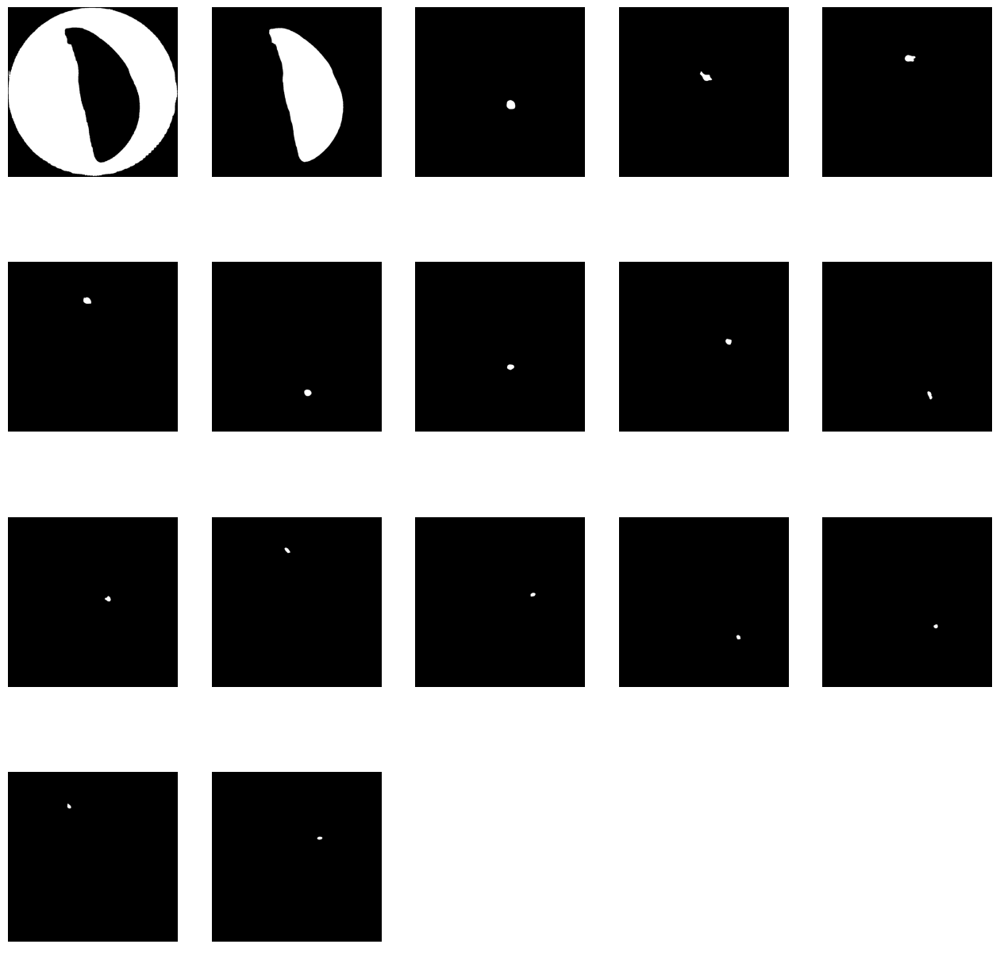

In [ ]:
from segment_anything import SamAutomaticMaskGenerator, sam_model_registry
import cv2
import os
import supervision as sv
import torch

DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
checkpoint = "weights/sam_vit_b_01ec64.pth"
model_type = "vit_b"
HOME = os.getcwd()

def binsem_sam(image, prompt):
  image_rgb = cv2.cvtColor(image, cv2.COLOR_GRAY2RGB)
  print(np.shape(image_rgb))
  #!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_b_01ec64.pth -P {HOME}/weights

  sam = sam_model_registry[model_type](checkpoint=checkpoint).to(device=DEVICE)
  predictor = SamAutomaticMaskGenerator(sam)
  masks = predictor.generate(image_rgb)

  print(np.shape(masks))
  print(masks)

  return masks

grayscale_image = images[5]
prompt = "Segment tissue"

result = binsem_sam(grayscale_image, prompt)

masks = [
    mask['segmentation']
    for mask
    in sorted(result, key=lambda x: x['area'], reverse=True)
]

print(len(masks))

sv.plot_images_grid(images=masks, grid_size=(4,5), size=(16, 16))

# Validation & Testing

In [ ]:
from keras.saving import load_model

In [ ]:
#testing on new images - zoomed ones

model = load_model('BEST_MODEL_100ep.keras')

/content/drive/MyDrive/datasets/lung2/zoomed/imgs2/


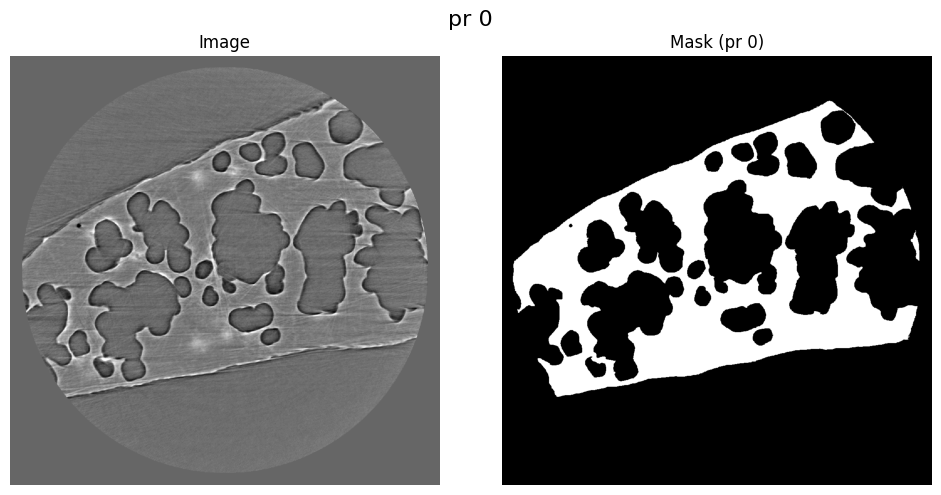

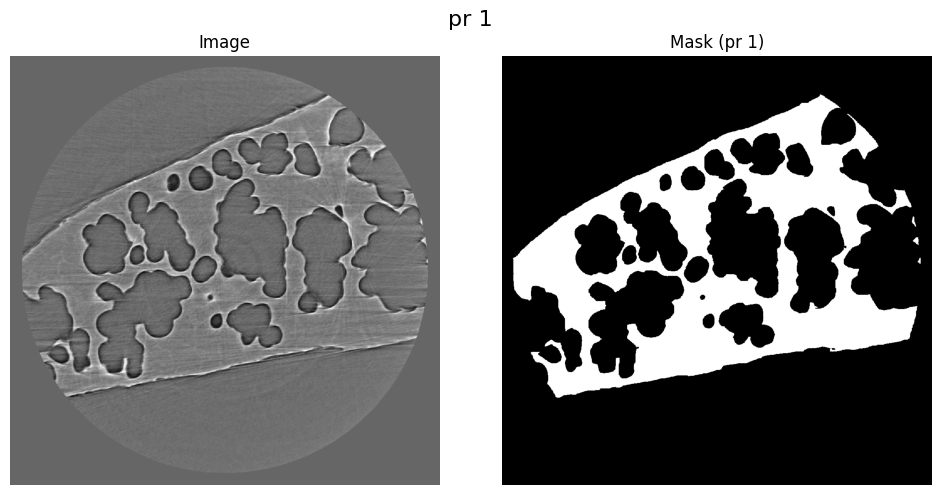

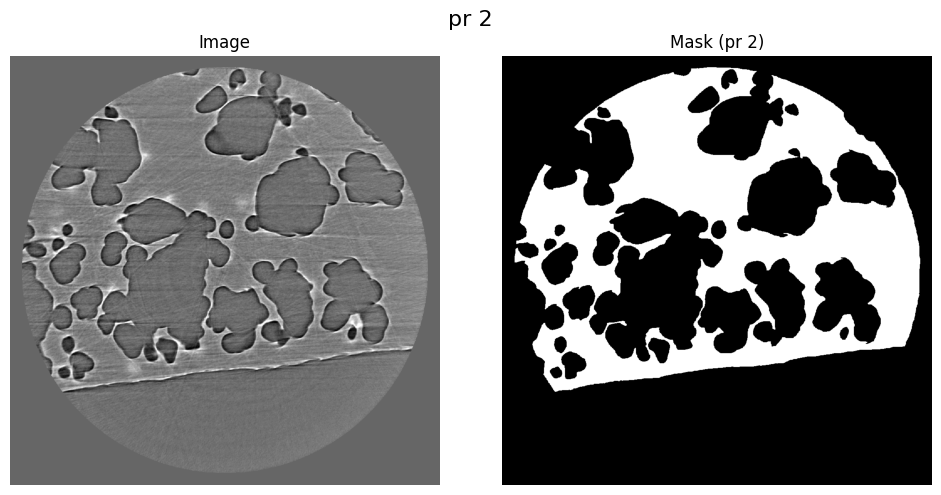

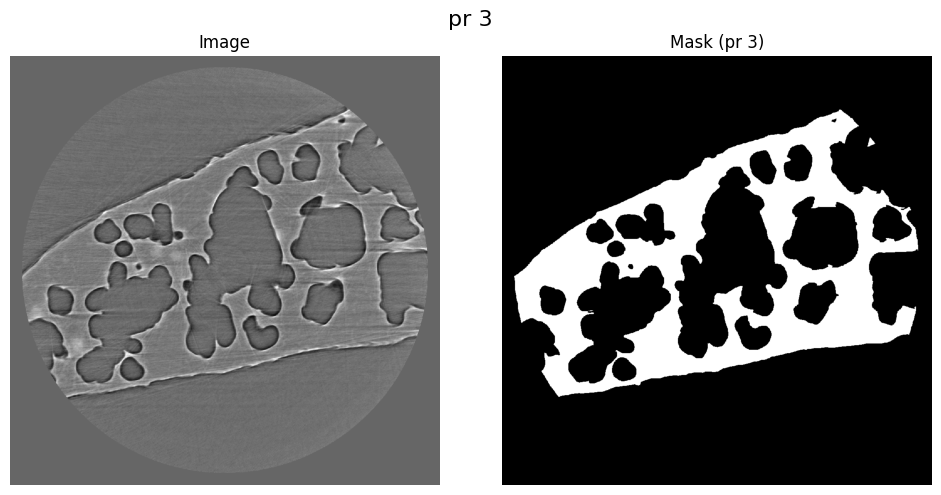

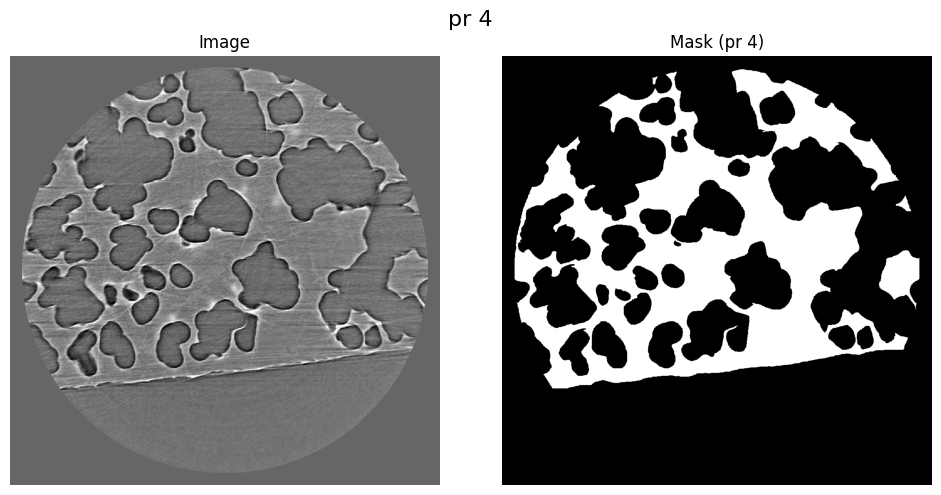

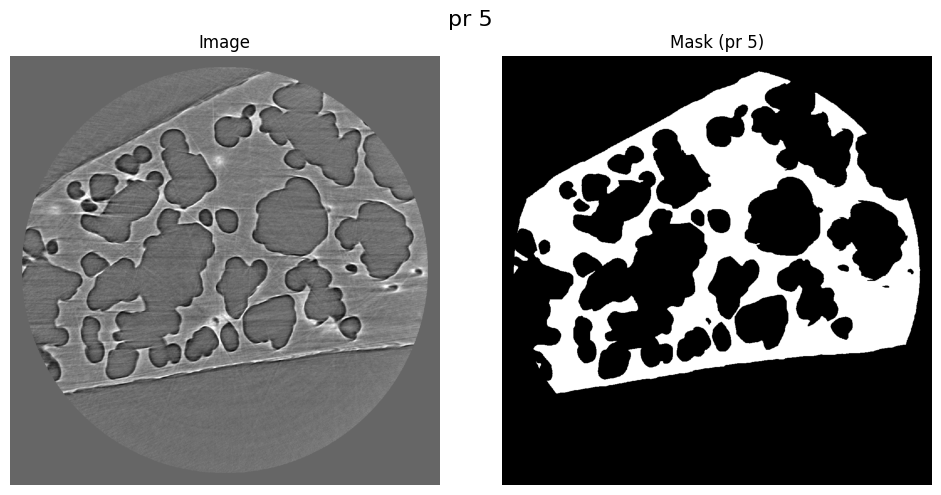

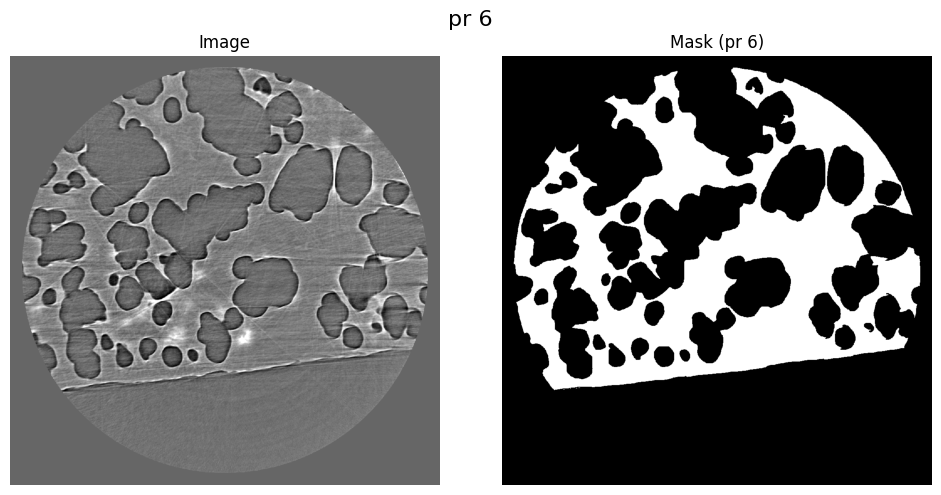

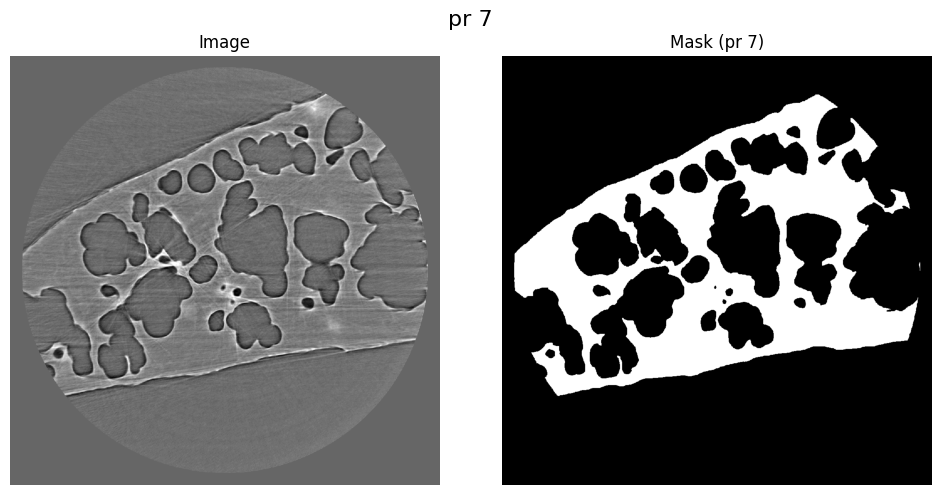

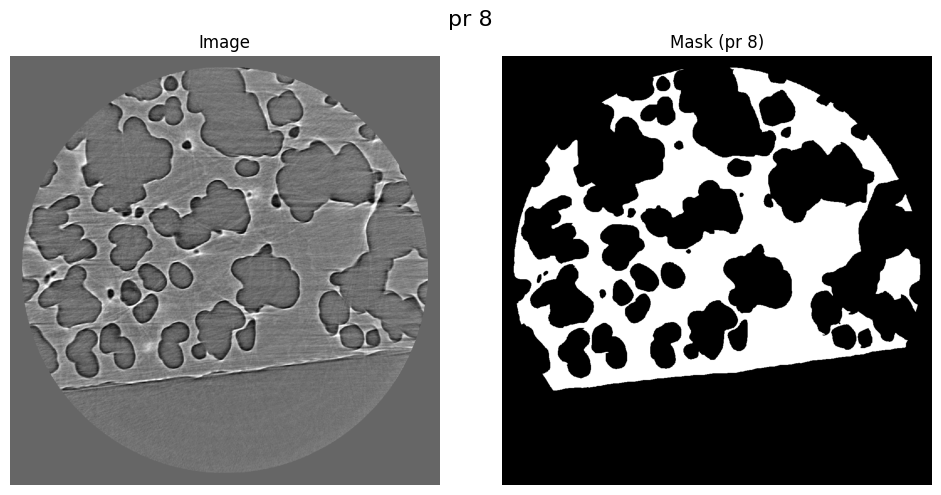

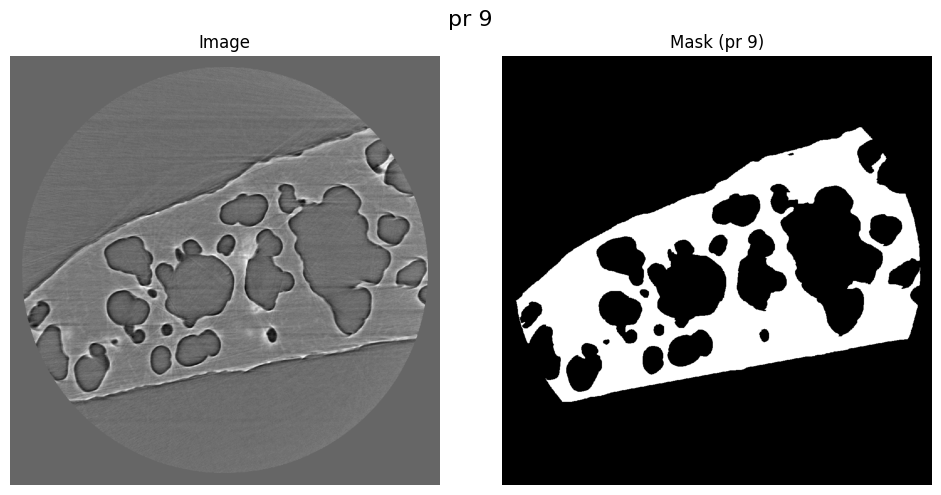

In [ ]:
timgs, tmasks = load_and_preprocess_data(TESTIMGS, TESTMASKS, INPUT)
timgs = timgs.astype(np.float32)
tmasks = tmasks.astype(np.float32)

for i in range(len(timgs)):
  plot_image(timgs[i], tmasks[i], title=f"pr {i}")

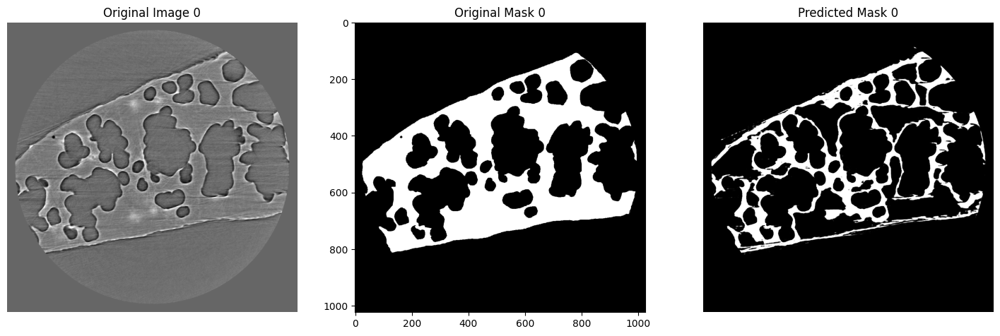

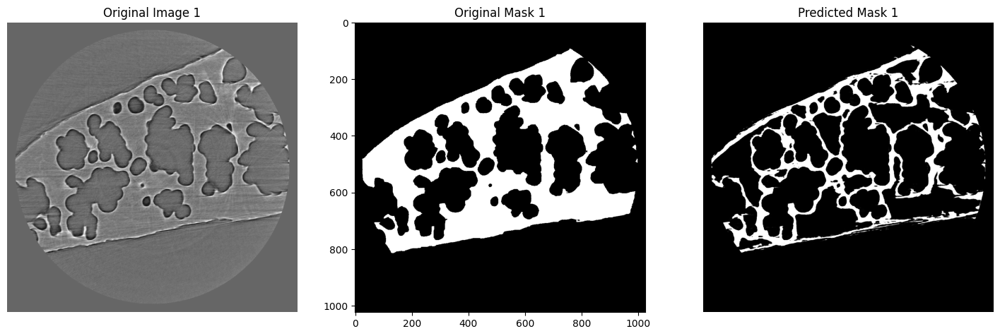

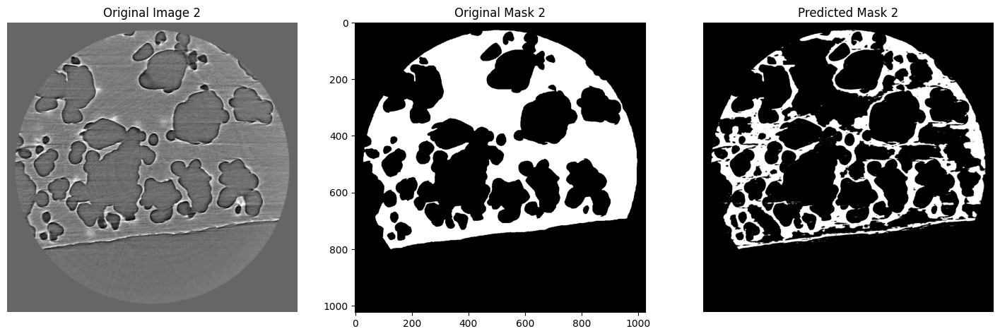

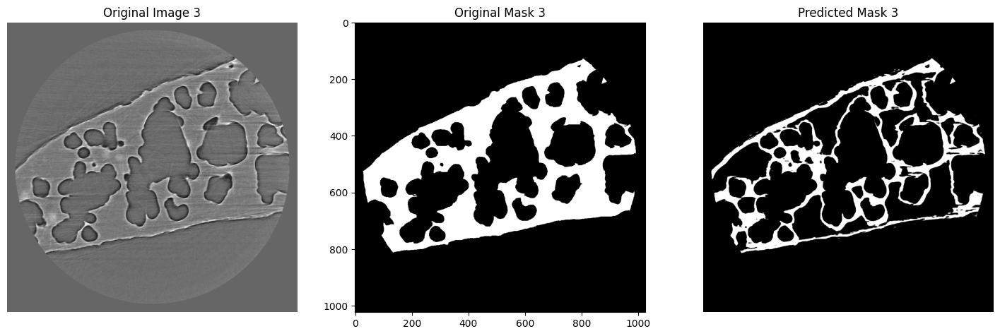

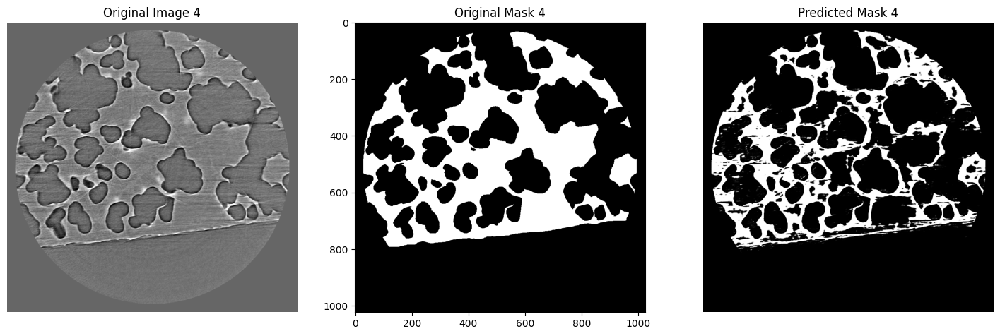

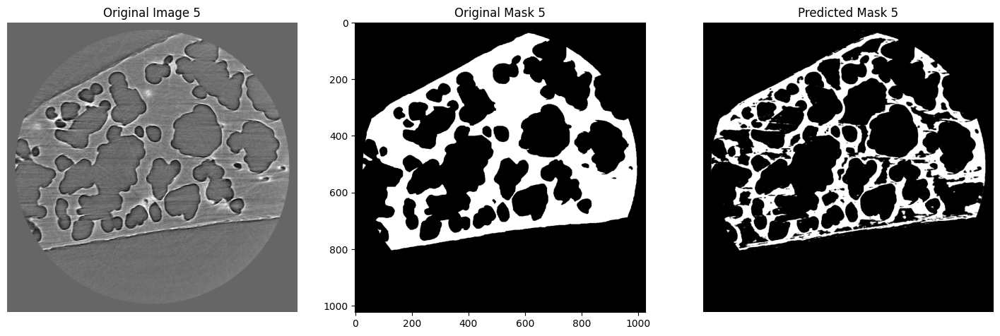

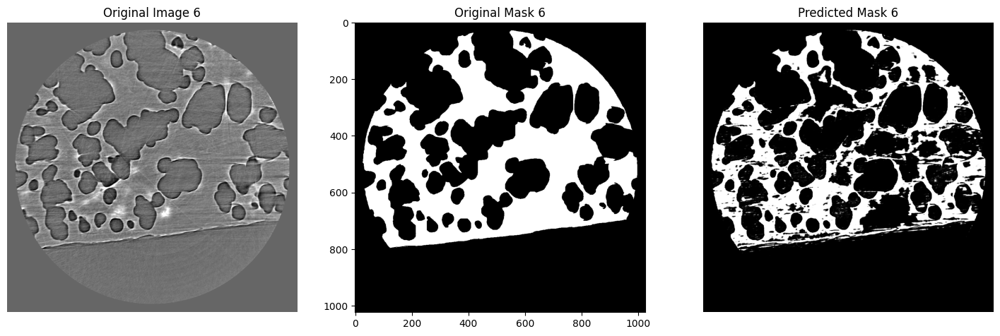

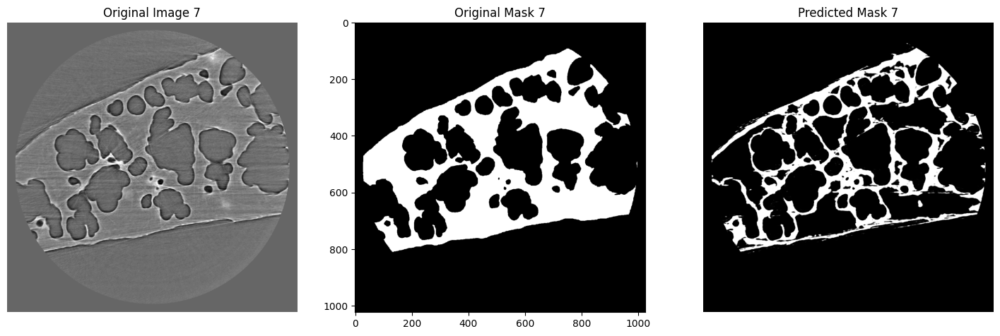

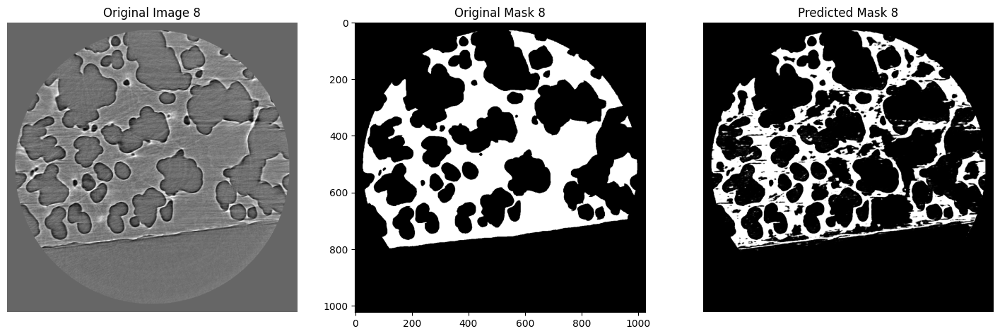

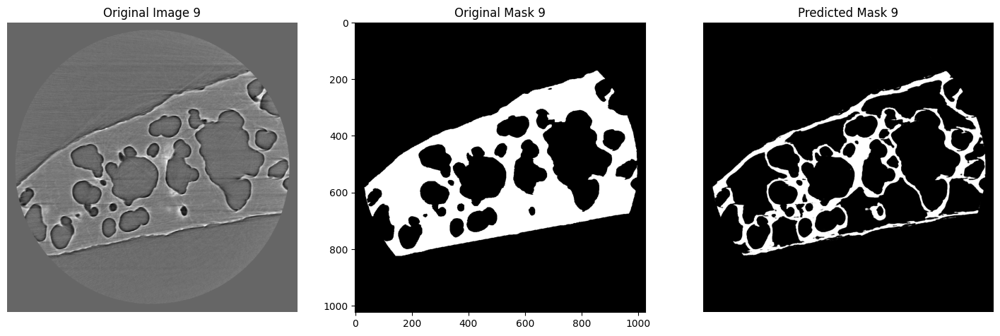

In [ ]:
for ind in range(len(timgs)): #test za zoomed-in slike
    pred = model(np.expand_dims(timgs[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.title(f"Original Image {ind}")
    plt.imshow(timgs[ind], cmap='gray')
    plt.axis('off')
    plt.subplot(1,3,2)
    plt.title(f"Original Mask {ind}")
    plt.imshow(tmasks[ind], cmap='gray')

    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    plt.subplot(1,3,3)
    plt.title(f"Predicted Mask {ind}")
    plt.imshow(pred, cmap='gray')
    plt.axis('off')
    plt.show()

In [ ]:
for layer in model.layers:
    layer.trainable = False

In [ ]:
for layer in model.layers:
    print(layer)

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import ModelCheckpoint

checkpoint_callback = ModelCheckpoint(filepath='model2.keras',
                                      monitor='val_loss',
                                      save_best_only=True,
                                      save_weights_only=False,
                                      mode='min',
                                      verbose=1)

early_stopping_callback = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3)
loss_fn = tf.keras.losses.BinaryCrossentropy()

#for l in model.layers[20:]: #samo dekoder
#  l.trainable = True

model.layers[-1].trainable = True
model.compile(optimizer=optimizer, loss=loss_fn)

history = model.fit(timgs, tmasks, epochs=100, validation_split=0.3, batch_size=1, callbacks=[early_stopping_callback, checkpoint_callback])


Epoch 1/100
7/7 [==============================] - ETA: 0s - loss: 0.0335
Epoch 1: val_loss improved from inf to 0.03150, saving model to model2.keras
7/7 [==============================] - 6s 504ms/step - loss: 0.0335 - val_loss: 0.0315
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.0321
Epoch 2: val_loss improved from 0.03150 to 0.03146, saving model to model2.keras
7/7 [==============================] - 2s 230ms/step - loss: 0.0321 - val_loss: 0.0315
Epoch 3/100
7/7 [==============================] - ETA: 0s - loss: 0.0326
Epoch 3: val_loss improved from 0.03146 to 0.03145, saving model to model2.keras
7/7 [==============================] - 2s 232ms/step - loss: 0.0326 - val_loss: 0.0315
Epoch 4/100
7/7 [==============================] - ETA: 0s - loss: 0.0320
Epoch 4: val_loss did not improve from 0.03145
7/7 [==============================] - 1s 186ms/step - loss: 0.0320 - val_loss: 0.0315
Epoch 5/100
7/7 [==============================] - ETA: 0s - loss: 0.0

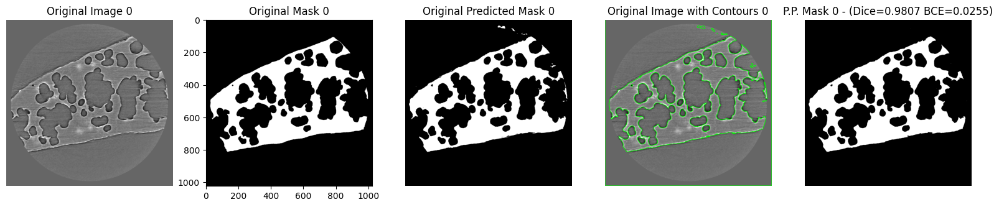

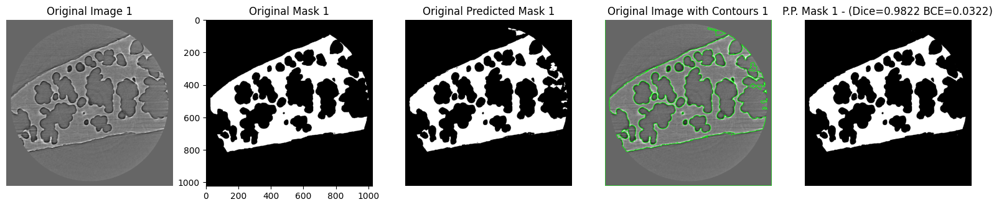

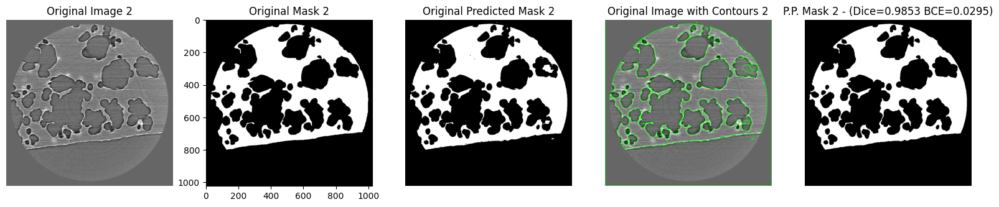

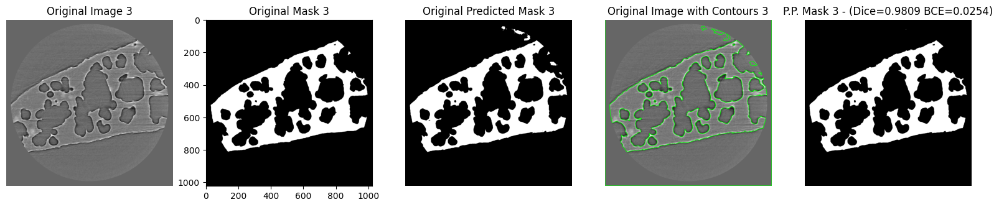

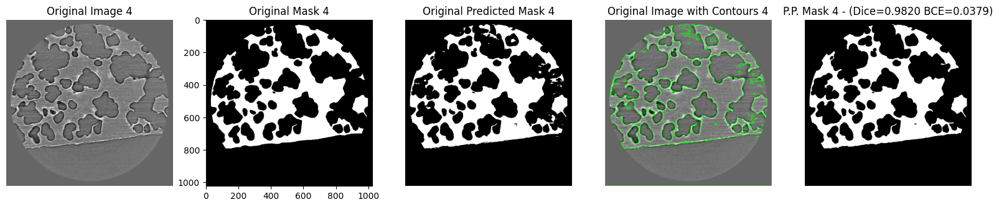

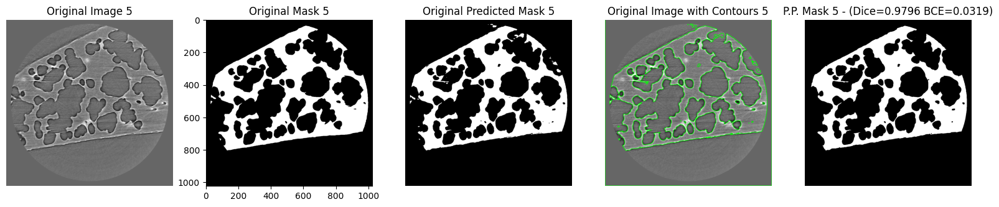

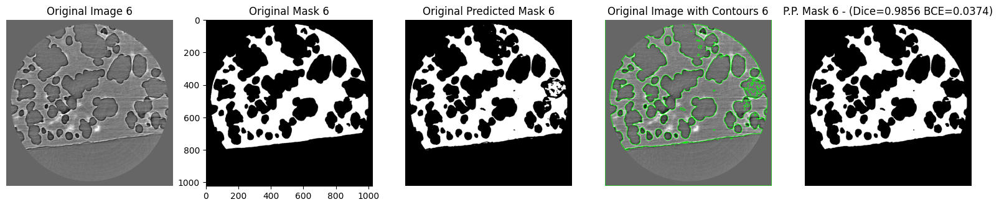

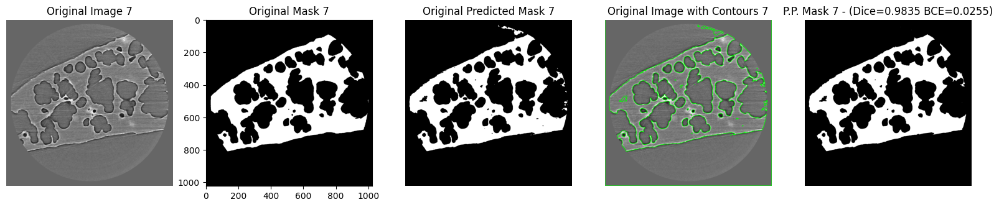

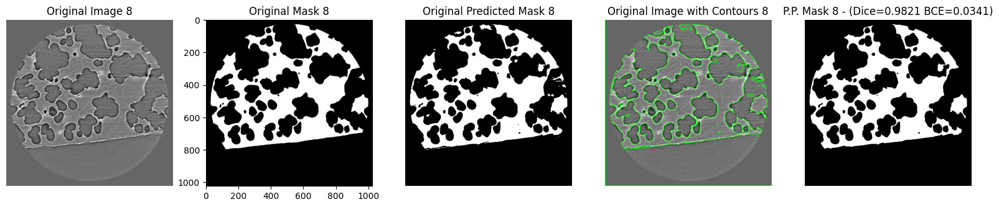

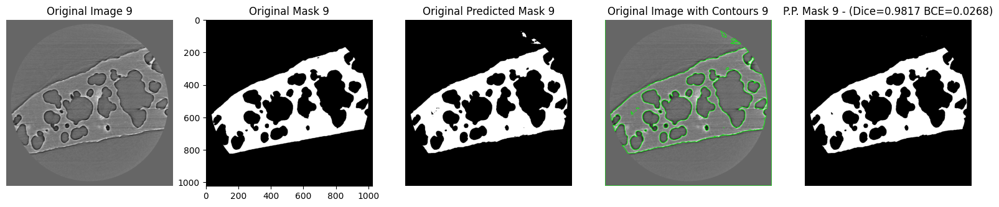

Classification Report:
              precision    recall  f1-score   support

           0     0.9942    0.9940    0.9941   7846269
           1     0.9822    0.9829    0.9825   2639491

    accuracy                         0.9912  10485760
   macro avg     0.9882    0.9884    0.9883  10485760
weighted avg     0.9912    0.9912    0.9912  10485760

Confusion Matrix:
[[7799162   47107]
 [  45251 2594240]]
Mean Dice=0.9823597727208095 Mean BCE=0.030623966827988625


In [ ]:
import cv2
from sklearn.metrics import classification_report, confusion_matrix

model2 = load_model('finetuned_model.keras')
mean_dice = []
mean_bce = []
y_true = []
y_pred = []

for ind in range(len(timgs)): # test za zoomed-in slike posle fine-tuning-a
    pred = model2(np.expand_dims(timgs[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(20,4))
    plt.subplot(1,5,1)
    plt.title(f"Original Image {ind}")
    plt.imshow(timgs[ind], cmap='gray')
    plt.axis('off')
    plt.subplot(1,5,2)
    plt.title(f"Original Mask {ind}")
    plt.imshow(tmasks[ind], cmap='gray')

    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]
    pred_np = pred.numpy()
    pred_thresh = (pred_np > 0.5).astype(np.uint8) * 255

    plt.subplot(1,5,3)
    plt.title(f"Original Predicted Mask {ind}")
    plt.imshow(pred_thresh, cmap='gray')
    plt.axis('off')

    blur = cv2.GaussianBlur(pred_thresh, (3, 3), 0)
    thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    cnts, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    mask = np.zeros_like(pred_thresh)
    for c in cnts:
        area = cv2.contourArea(c)
        if area < 7500:  #7500 najbolje
            cv2.drawContours(mask, [c], -1, (255), thickness=cv2.FILLED)

    result = cv2.bitwise_and(pred_thresh, 255 - mask)

    result = cv2.threshold(result, 0, 255, cv2.THRESH_BINARY)[1]

    original_with_contours = cv2.cvtColor(timgs[ind], cv2.COLOR_GRAY2RGB)
    cv2.drawContours(original_with_contours, cnts, -1, (0, 255, 0), 2)

    plt.subplot(1, 5, 4)
    plt.title(f"Original Image with Contours {ind}")
    plt.imshow(original_with_contours)
    plt.axis('off')

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
    close = cv2.morphologyEx(result, cv2.MORPH_CLOSE, kernel, iterations=2)

    dice = dice_coefficient(tmasks[ind], (close > 0.5).astype(int))
    binary_cross_entropy = tf.keras.losses.binary_crossentropy(tmasks[ind], pred)
    mean_binary_cross_entropy = tf.reduce_mean(binary_cross_entropy)

    mean_dice.append(dice)
    mean_bce.append(mean_binary_cross_entropy.numpy())

    y_true.append((tmasks[ind].flatten()>0.5).astype(int))
    y_pred.append((close.flatten()>0.5).astype(int))

    plt.subplot(1, 5, 5)
    plt.title(f"P.P. Mask {ind} - (Dice={dice:.4f} BCE={mean_binary_cross_entropy:.4f})")
    plt.imshow(close, cmap='gray')
    plt.axis('off')
    plt.show()

y_true = np.concatenate(y_true)
y_pred = np.concatenate(y_pred)

print("Classification Report:")
print(classification_report(y_true, y_pred, digits=4))

print("Confusion Matrix:")
conf_matrix = confusion_matrix(y_true, y_pred)
print(conf_matrix)

print(f"Mean Dice={np.mean(mean_dice)} Mean BCE={np.mean(mean_bce)}")

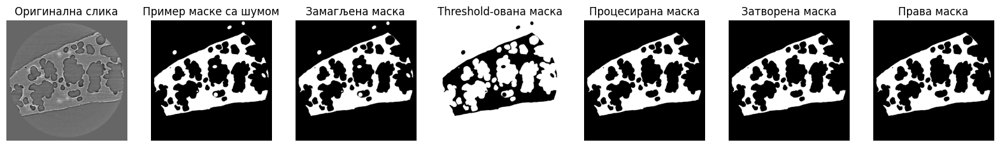

In [ ]:
import cv2
import numpy as np

def add_random_ellipses(image, num_ellipses=10, max_radius=25):
    noisy_image = image.copy()
    rows, cols = noisy_image.shape

    for _ in range(num_ellipses):
        center_x = np.random.randint(max_radius, cols - max_radius)
        center_y = np.random.randint(max_radius, rows - max_radius)
        axis_x = np.random.randint(5, max_radius)
        axis_y = np.random.randint(5, max_radius)
        angle = np.random.randint(0, 360)

        cv2.ellipse(noisy_image, (center_x, center_y), (axis_x, axis_y), angle, 0, 360, 255, -1)

    return noisy_image

mask = tmasks[0]
img = timgs[0]

mask = (mask > 0.5).astype(np.uint8) * 255

mask = add_random_ellipses(mask)

plt.figure(figsize=(20, 4))
plt.subplot(1, 7, 1)
plt.title(f"Оригинална слика")
plt.imshow(timgs[ind], cmap='gray')
plt.axis('off')

plt.subplot(1, 7, 2)
plt.title(f"Пример маске са шумом")
plt.imshow(mask, cmap='gray')
plt.axis('off')

blur = cv2.GaussianBlur(mask, (3, 3), 0)
plt.subplot(1, 7, 3)
plt.title(f"Замагљена маска")
plt.imshow(blur, cmap='gray')
plt.axis('off')

thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
plt.subplot(1, 7, 4)
plt.title(f"Threshold-ована маска")
plt.imshow(thresh, cmap='gray')
plt.axis('off')

cnts, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
mask_contours = np.zeros_like(mask)
for c in cnts:
    area = cv2.contourArea(c)
    if area < 7500:  #7500 najbolje
        cv2.drawContours(mask_contours, [c], -1, (255), thickness=cv2.FILLED)

result = cv2.bitwise_and(mask, 255 - mask_contours)
result = cv2.threshold(result, 0, 255, cv2.THRESH_BINARY)[1]
plt.subplot(1, 7, 5)
plt.title(f"Процесирана маска")
plt.imshow(result, cmap='gray')
plt.axis('off')

kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (3, 3))
close = cv2.morphologyEx(result, cv2.MORPH_CLOSE, kernel, iterations=2)
plt.subplot(1, 7, 6)
plt.title(f"Затворена маска")
plt.imshow(close, cmap='gray')
plt.axis('off')

plt.subplot(1, 7, 7)
plt.title(f"Права маска")
plt.imshow(tmasks[0], cmap='gray')
plt.axis('off')

plt.show()

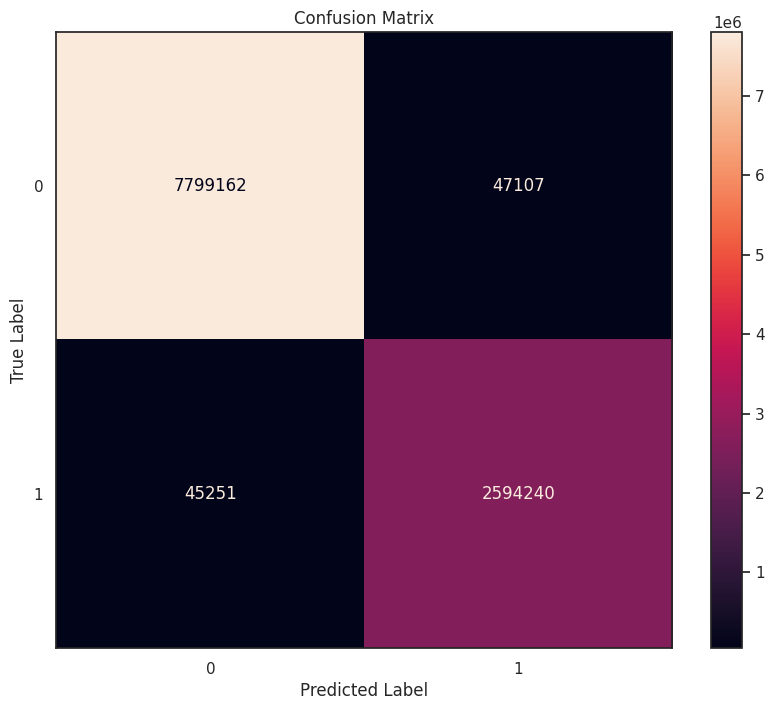

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

sns.set(style="white")
plt.figure(figsize=(10, 8))
class_labels = [0, 1]

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_labels)
disp.plot(cmap="rocket", values_format=".0f", ax=plt.gca(), xticks_rotation='horizontal')

plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

In [ ]:
#del train_images, train_masks

#val_images, val_masks = get_split_eff(images, masks, which = False)

#ind = np.random.choice(len(val_images),1,replace=False)

import matplotlib.pyplot as plt

#support_images, support_masks, _, _ = create_episode(images, masks, min_query_samples=2)

#val_masks = np.array(val_masks, dtype=np.float32)
#val_images = np.expand_dims(val_images, axis = -1)

#val_masks = tf.squeeze(val_masks, axis=-1)

print(np.shape(val_images),np.shape(val_masks))

#val_masks = np.array(val_masks, dtype=np.float32)
#val_masks = np.expand_dims(val_masks, axis = -1)

for ind in range(len(val_images)):
    pred = model(np.expand_dims(val_images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.imshow(val_images[ind], cmap='gray')
    plt.axis('off')
    plt.subplot(1,3,2)
    plt.imshow(val_masks[ind], cmap='gray')

    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    plt.subplot(1,3,3)
    plt.imshow(pred, cmap='gray')
    plt.axis('off')
    plt.show()



NameError: name 'val_images' is not defined

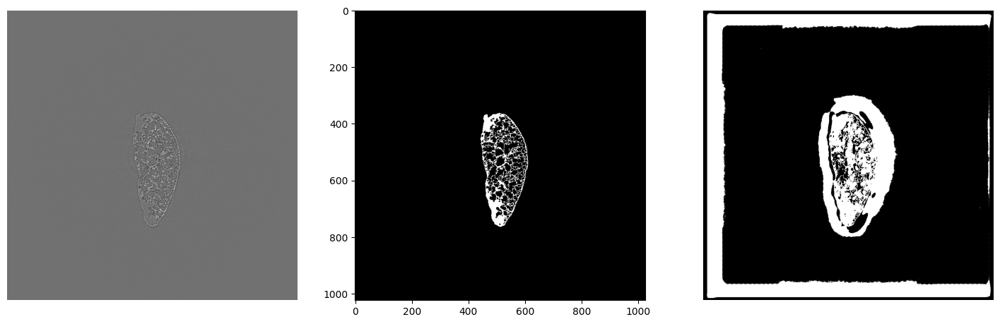

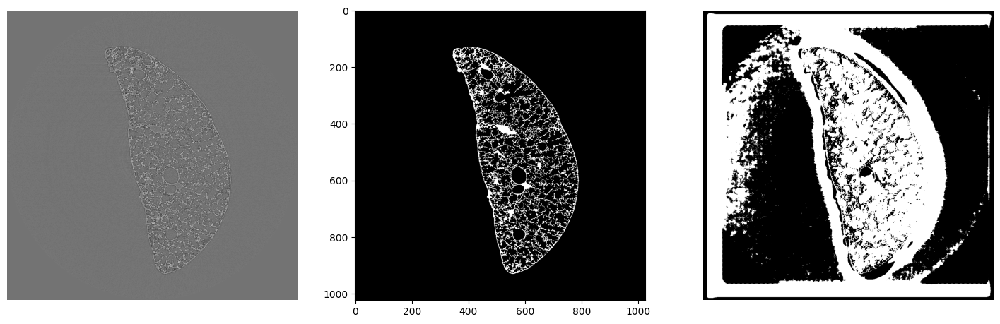

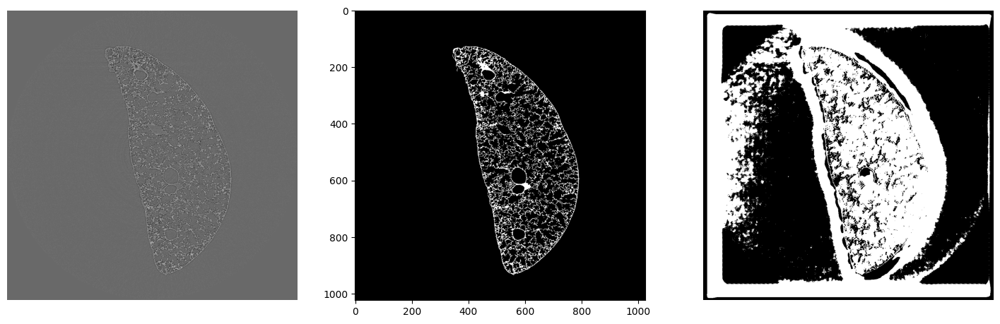

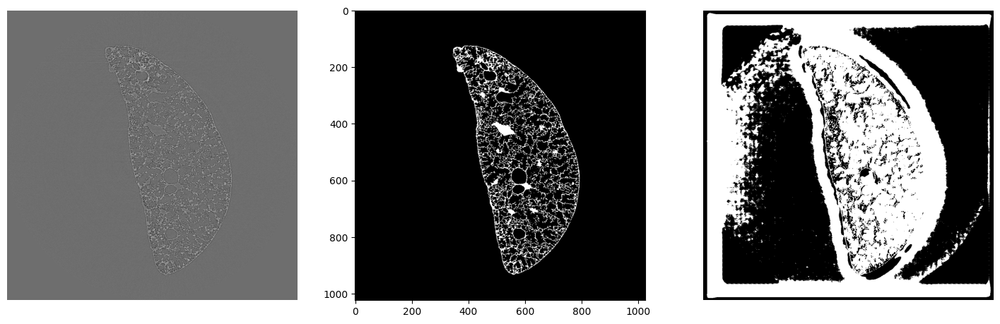

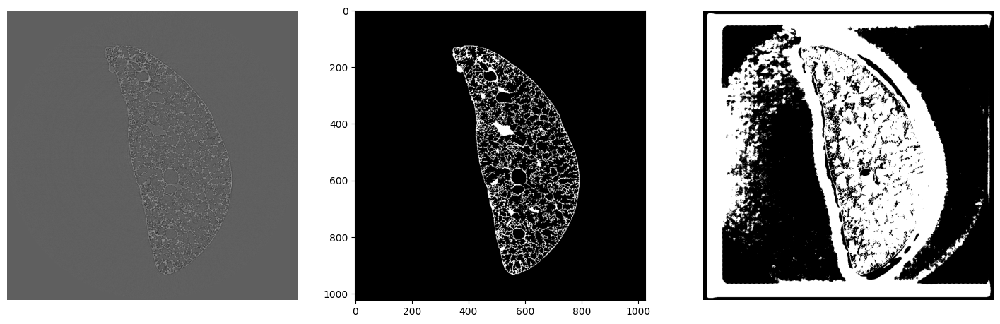

...

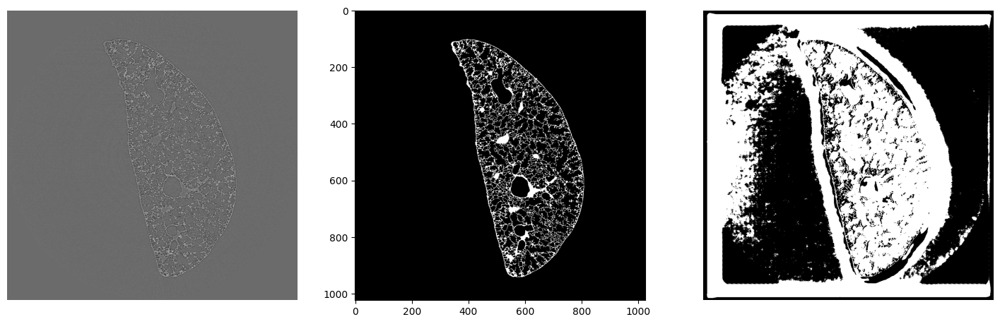

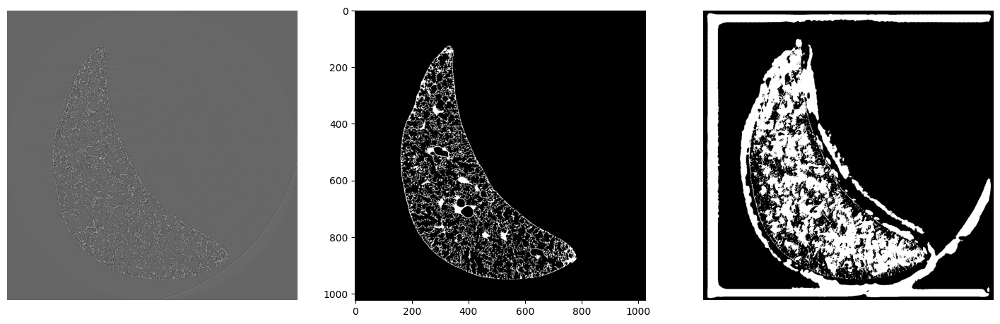

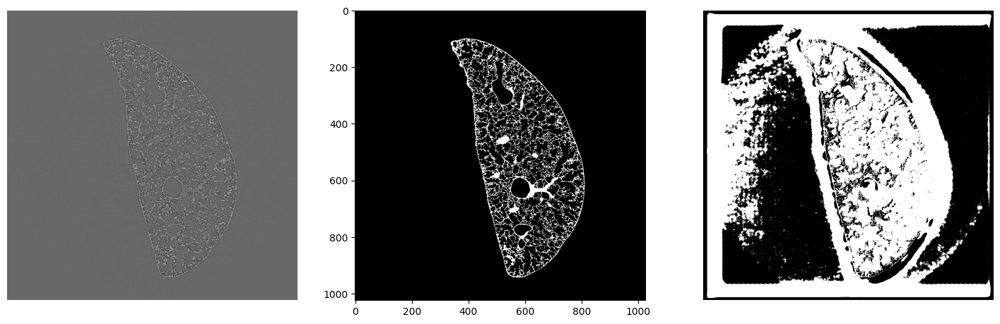

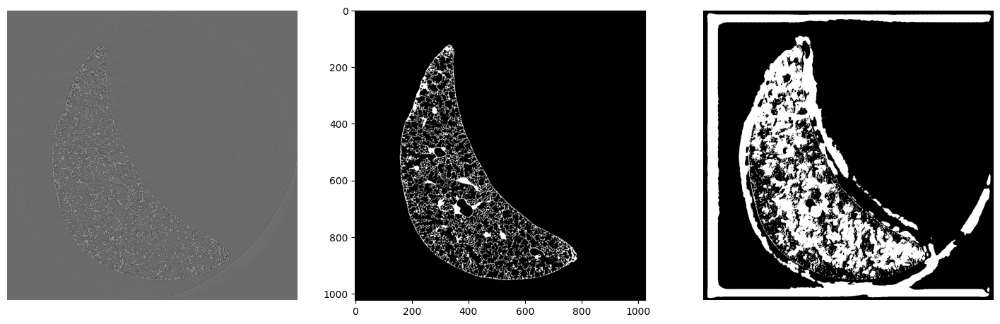

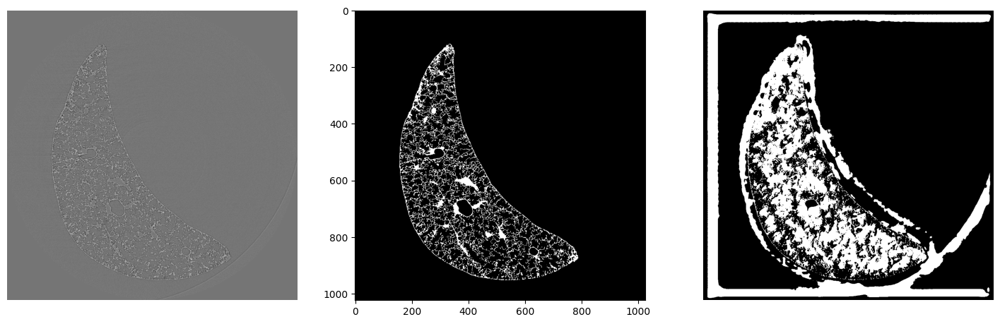

In [ ]:
for ind in range(len(images)): #finetuned model test na celim plucima
    pred = model2(np.expand_dims(images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.imshow(images[ind], cmap='gray')
    plt.axis('off')
    plt.subplot(1,3,2)
    plt.imshow(masks[ind], cmap='gray')

    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    plt.subplot(1,3,3)
    plt.imshow(pred > 0.5, cmap='gray')
    plt.axis('off')
    plt.show()

In [ ]:
for ind in range(len(val_images)):
    pred = model(np.expand_dims(val_images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)
    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    actual = val_masks[ind]
    print(np.shape(pred), np.shape(actual))

    dice = dice_coefficient(actual, pred > 0.5)
    print(f"El: {ind}\tDice:{dice}")


(1024, 1024) (1024, 1024)
El: 0	Dice:0.9371771710803346
(1024, 1024) (1024, 1024)
El: 1	Dice:0.914536880187305
(1024, 1024) (1024, 1024)
El: 2	Dice:0.8651514706158643
(1024, 1024) (1024, 1024)
El: 3	Dice:0.6581015691602319
(1024, 1024) (1024, 1024)
El: 4	Dice:0.8712369877266025


In [ ]:
images, masks = load_and_preprocess_data(IMGS, MASKS, INPUT)
images = images.astype(np.float32)
masks = masks.astype(np.float32)

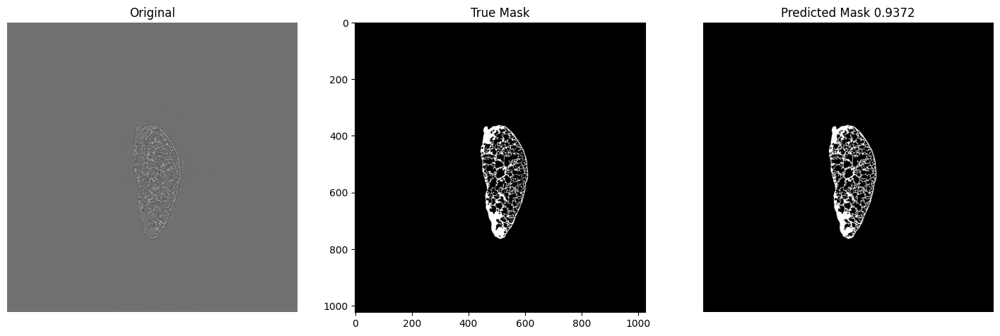

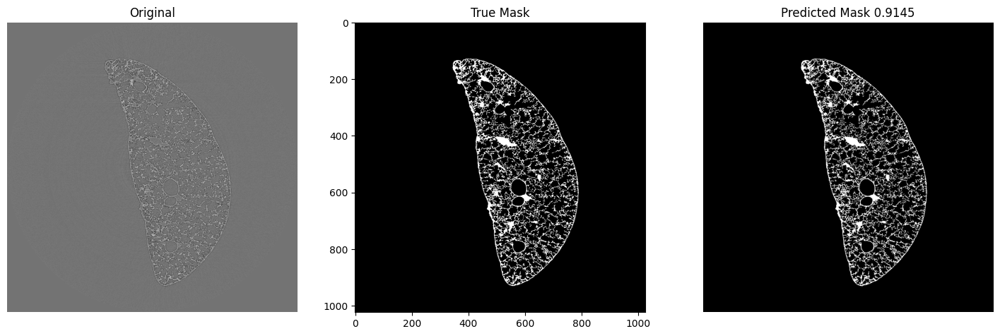

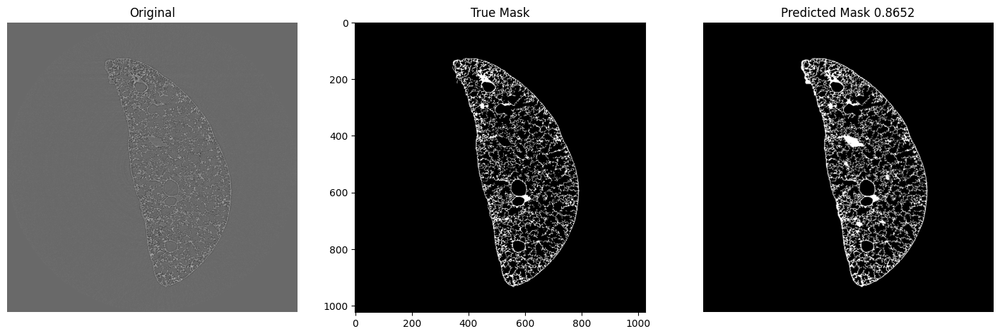

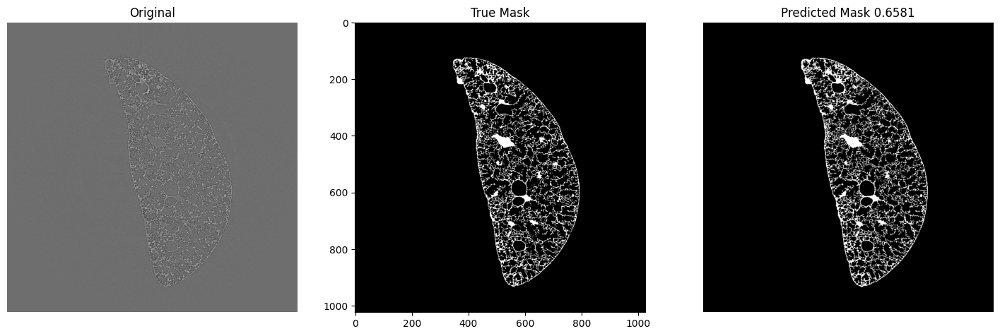

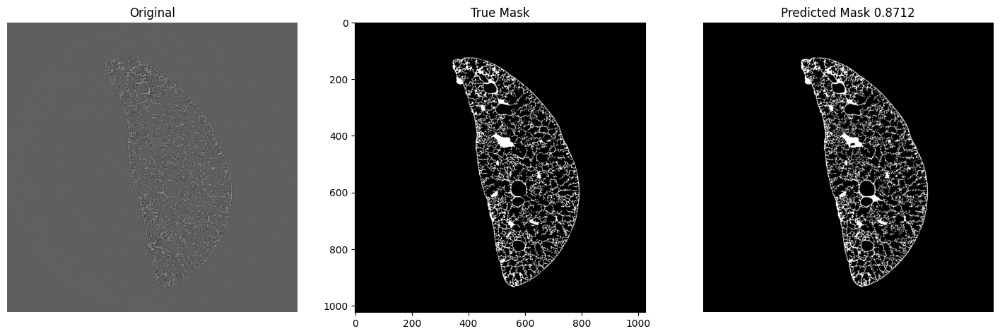

...

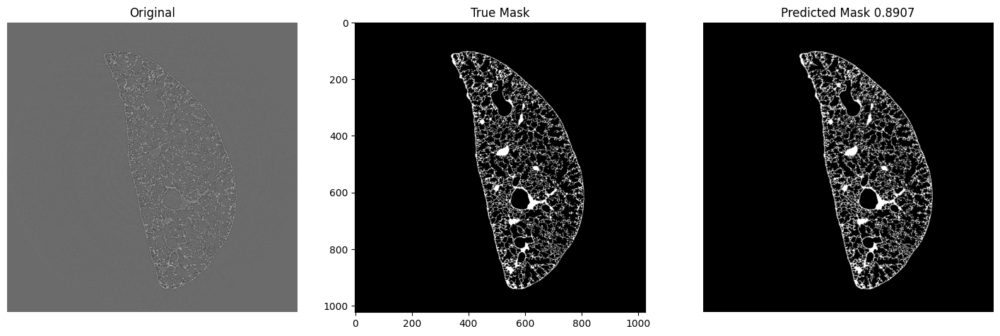

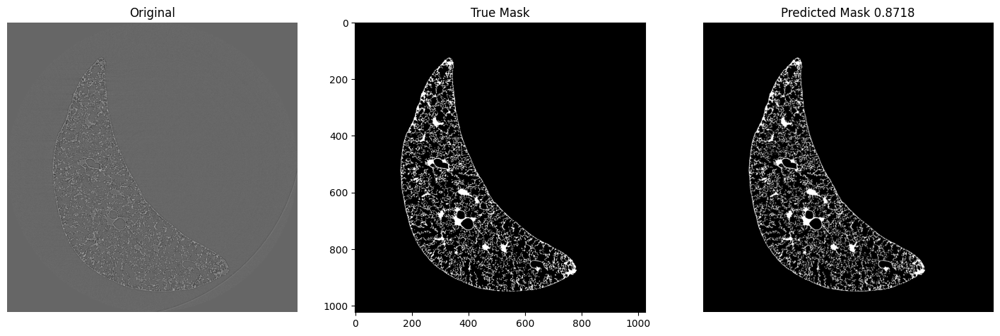

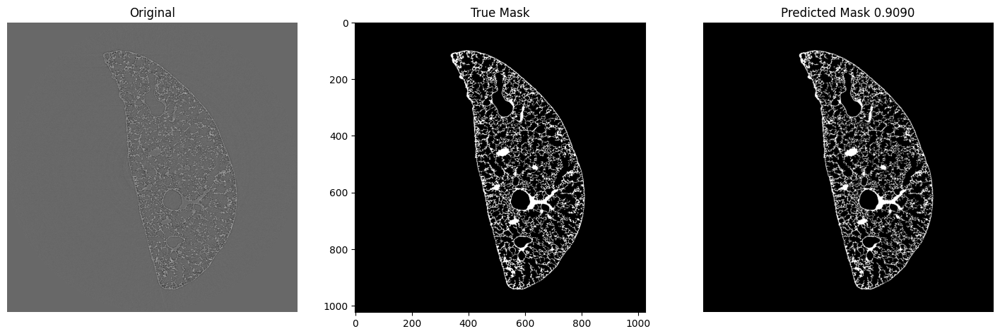

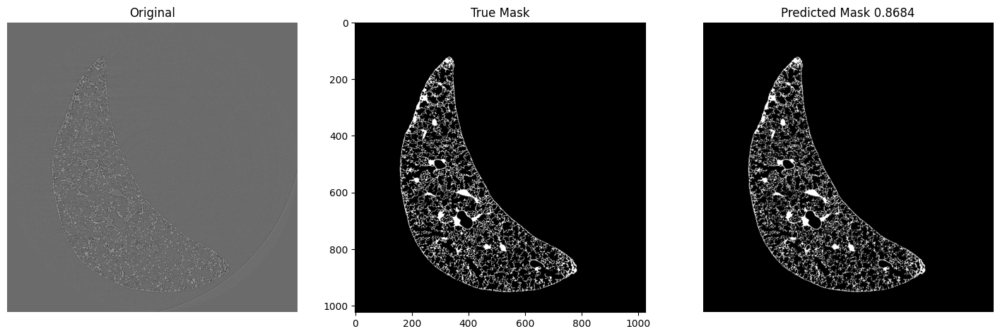

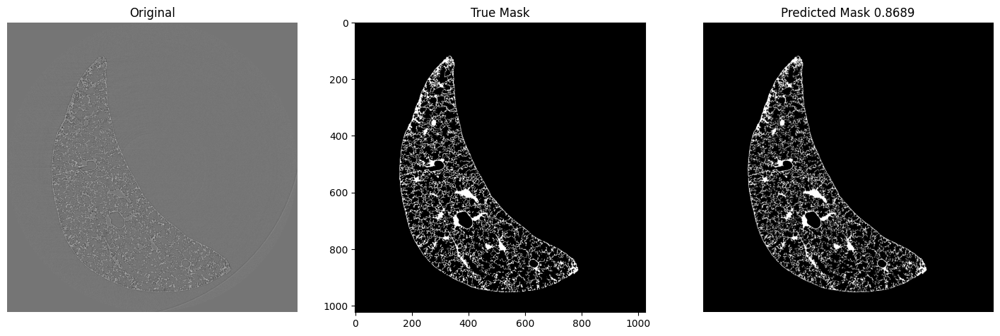

In [ ]:
for ind in range(len(images)):
    pred = model(np.expand_dims(images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(18,6))
    plt.subplot(1,3,1)
    plt.title('Original')
    plt.imshow(images[ind], cmap='gray')
    plt.axis('off')
    plt.subplot(1,3,2)
    plt.title('True Mask')
    plt.imshow(masks[ind], cmap='gray')

    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    dice = dice_coefficient(masks[ind], pred > 0.5)

    plt.subplot(1,3,3)
    plt.title(f'Predicted Mask {dice:.4f}')
    plt.imshow(pred, cmap='gray')
    plt.axis('off')
    plt.show()

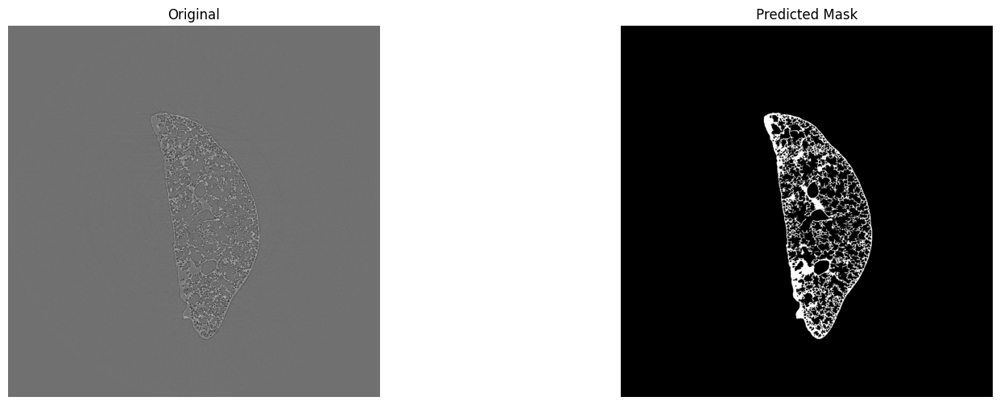

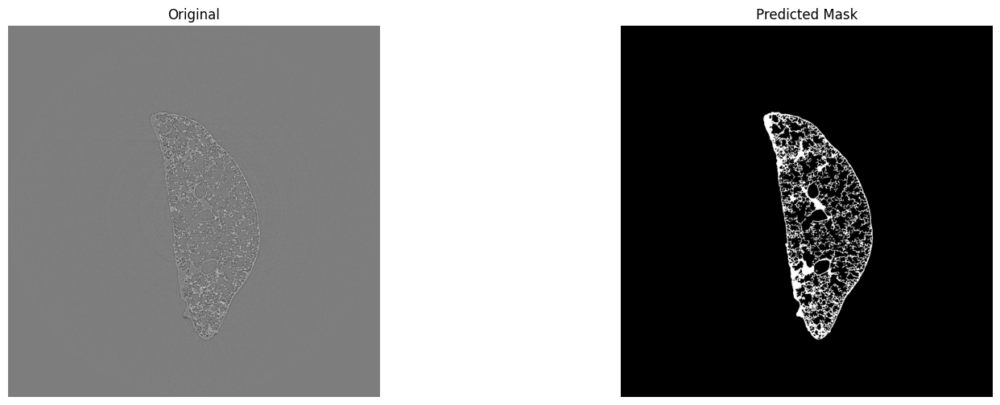

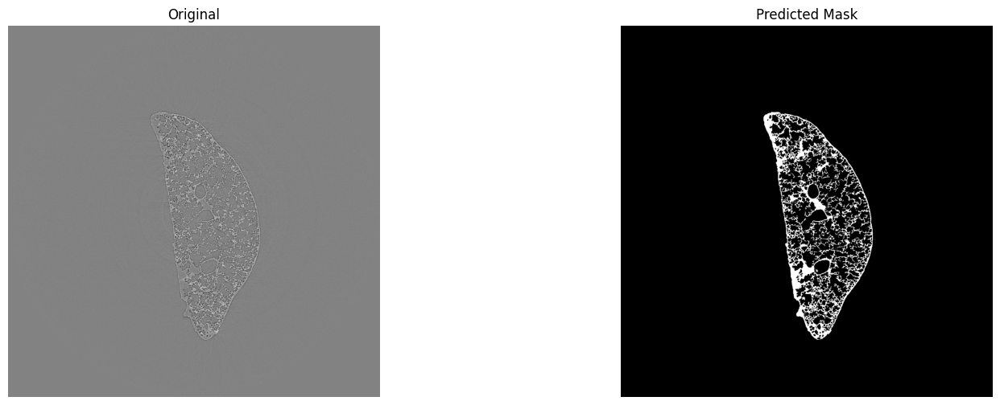

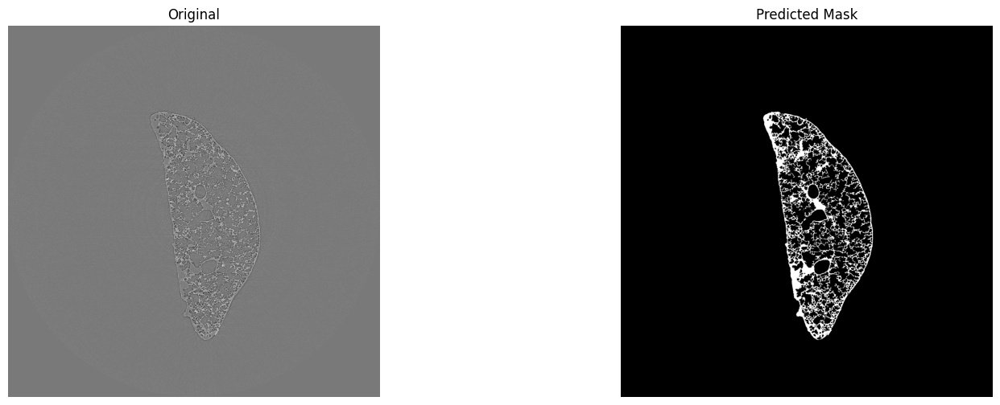

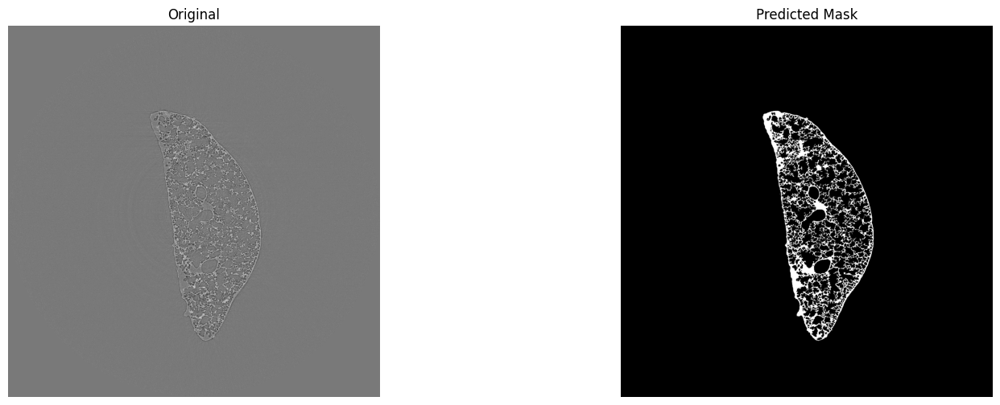

...

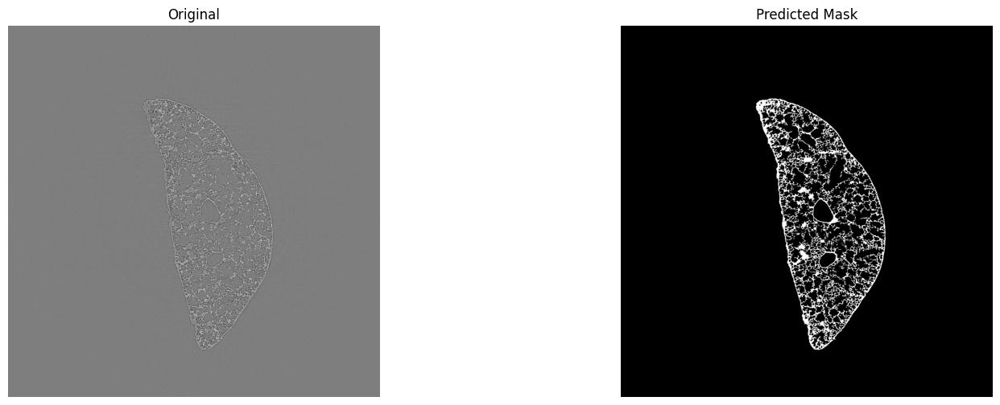

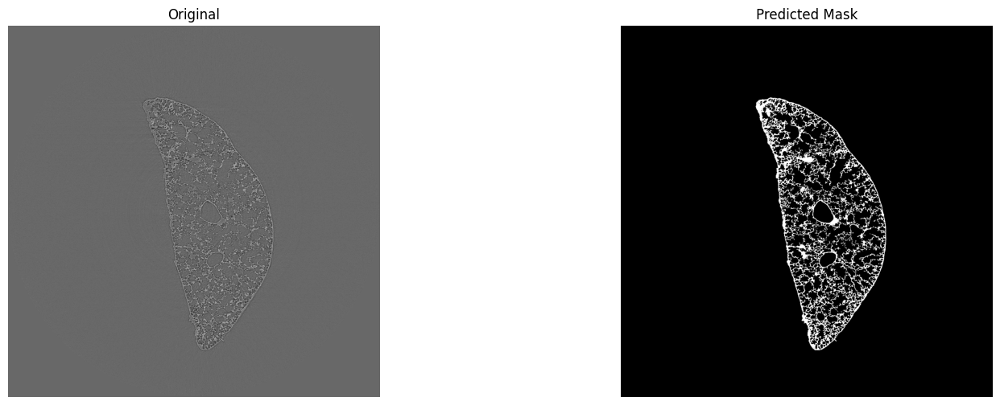

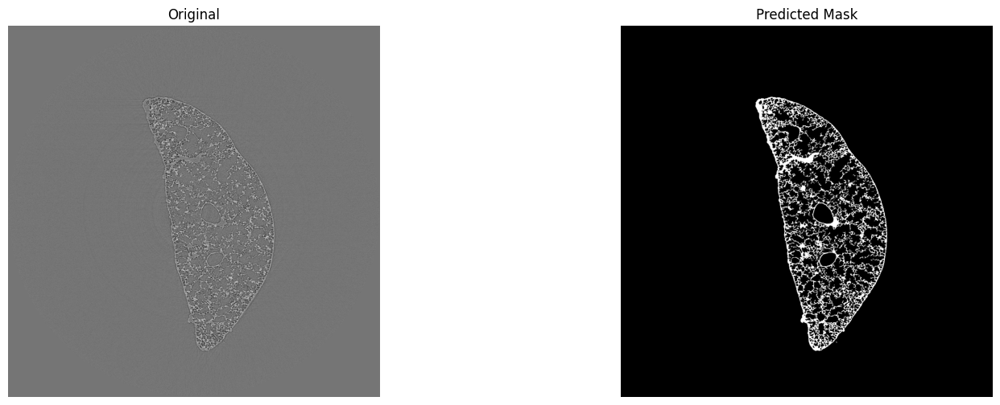

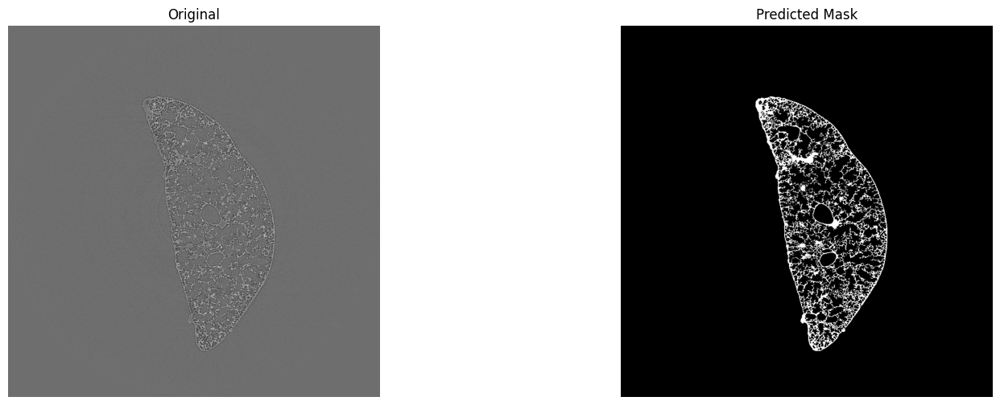

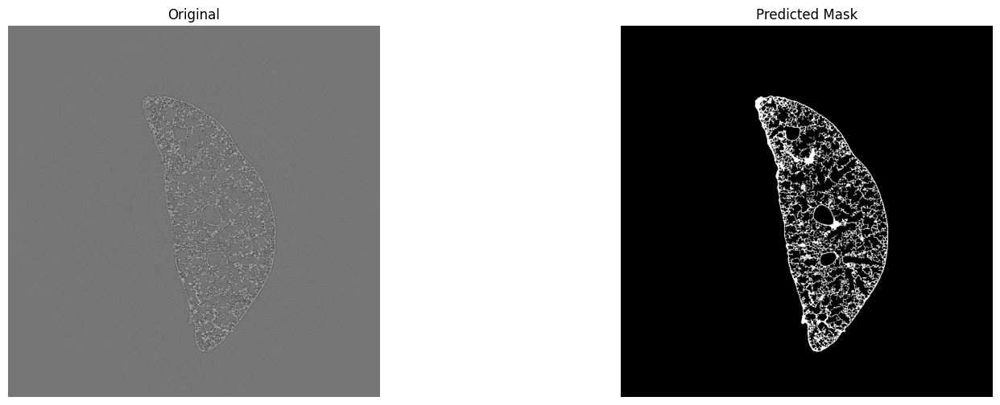

In [ ]:
for ind in range(len(test_images)):
    pred = model(np.expand_dims(test_images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)

    plt.figure(figsize=(18,6))
    plt.subplot(1,2,1)
    plt.title('Original')
    plt.imshow(test_images[ind], cmap='gray')
    plt.axis('off')
    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    plt.subplot(1,2,2)
    plt.title(f'Predicted Mask')
    plt.imshow(pred, cmap='gray')
    plt.axis('off')
    plt.show()

In [ ]:
dice_coefficients = []

for ind in range(len(images)):
    pred = model(np.expand_dims(images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)
    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    actual = masks[ind]
    print(np.shape(pred), np.shape(actual))

    dice = dice_coefficient(actual, pred > 0.5)
    dice_coefficients.append(dice)
    print(f"El: {ind}\tDice:{dice}")

mean_dice = np.mean(dice_coefficients)
print(f"Mean Dice Coefficient (All samples: {mean_dice}")

(1024, 1024) (1024, 1024)
El: 0	Dice:0.9371771710803346
(1024, 1024) (1024, 1024)
El: 1	Dice:0.914536880187305
(1024, 1024) (1024, 1024)
El: 2	Dice:0.8651514706158643
(1024, 1024) (1024, 1024)
El: 3	Dice:0.6581015691602319
(1024, 1024) (1024, 1024)
El: 4	Dice:0.8712369877266025
(1024, 1024) (1024, 1024)
El: 5	Dice:0.8874134163159413
(1024, 1024) (1024, 1024)
El: 6	Dice:0.8850141911177849
(1024, 1024) (1024, 1024)
El: 7	Dice:0.8831492401071201
(1024, 1024) (1024, 1024)
El: 8	Dice:0.8892590266691006
(1024, 1024) (1024, 1024)
El: 9	Dice:0.8873588593037639
(1024, 1024) (1024, 1024)
El: 10	Dice:0.8456089011625797
(1024, 1024) (1024, 1024)
El: 11	Dice:0.8886116069903629
(1024, 1024) (1024, 1024)
El: 12	Dice:0.8907423604509578
(1024, 1024) (1024, 1024)
El: 13	Dice:0.8718354270085636
(1024, 1024) (1024, 1024)
El: 14	Dice:0.90903130635107
(1024, 1024) (1024, 1024)
El: 15	Dice:0.8683649188130218
(1024, 1024) (1024, 1024)
El: 16	Dice:0.8688618230851779
Mean Dice Coefficient (All samples: 0.871850

In [ ]:
binary_cross_entropies = []

for ind in range(len(images)):
    pred = model(np.expand_dims(images[ind], axis=0))  # Add an extra dimension for batch
    pred = np.array(pred)
    pred = tf.squeeze(pred, axis=-1)
    pred = pred[0]

    actual = masks[ind]
    print(np.shape(pred), np.shape(actual))

    binary_cross_entropy = tf.keras.losses.binary_crossentropy(actual, pred)
    mean_binary_cross_entropy = tf.reduce_mean(binary_cross_entropy)

    binary_cross_entropies.append(mean_binary_cross_entropy.numpy())

    print(f"El: {ind}\tMean Binary Cross Entropy: {mean_binary_cross_entropy.numpy()}")

mean_binary_cross_entropy_all_samples = np.mean(binary_cross_entropies)
print(f"Mean Binary Cross Entropy (All samples): {mean_binary_cross_entropy_all_samples}")

(1024, 1024) (1024, 1024)
El: 0	Mean Binary Cross Entropy: 0.006656101904809475
(1024, 1024) (1024, 1024)
El: 1	Mean Binary Cross Entropy: 0.02243182808160782
(1024, 1024) (1024, 1024)
El: 2	Mean Binary Cross Entropy: 0.04329351335763931
(1024, 1024) (1024, 1024)
El: 3	Mean Binary Cross Entropy: 0.11913634091615677
(1024, 1024) (1024, 1024)
El: 4	Mean Binary Cross Entropy: 0.034468598663806915
(1024, 1024) (1024, 1024)
El: 5	Mean Binary Cross Entropy: 0.02849760465323925
(1024, 1024) (1024, 1024)
El: 6	Mean Binary Cross Entropy: 0.028810571879148483
(1024, 1024) (1024, 1024)
El: 7	Mean Binary Cross Entropy: 0.029893364757299423
(1024, 1024) (1024, 1024)
El: 8	Mean Binary Cross Entropy: 0.02877574972808361
(1024, 1024) (1024, 1024)
El: 9	Mean Binary Cross Entropy: 0.029527612030506134
(1024, 1024) (1024, 1024)
El: 10	Mean Binary Cross Entropy: 0.03542996197938919
(1024, 1024) (1024, 1024)
El: 11	Mean Binary Cross Entropy: 0.02884163148701191
(1024, 1024) (1024, 1024)
El: 12	Mean Binary 

In [ ]:
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score

threshold = 0.5
true_labels = []
pred_labels = []
pred_asfl = []
for ind in range(len(images)):
    pred = model(np.expand_dims(images[ind], axis=0))
    pred_asfl.extend(pred.numpy().flatten())
    pred_binary = (pred.numpy() > threshold).astype(int)
    actual = masks[ind]
    true_binary = (actual > 0.5).astype(int)

    true_labels.extend(true_binary.flatten())
    pred_labels.extend(pred_binary.flatten())

conf_matrix = confusion_matrix(true_labels, pred_labels)

print("Confusion Matrix:")
print(conf_matrix)

precision_0 = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[1, 0])
precision_1 = conf_matrix[1, 1] / (conf_matrix[1, 1] + conf_matrix[0, 1])

recall_0 = conf_matrix[0, 0] / (conf_matrix[0, 0] + conf_matrix[0, 1])
recall_1 = conf_matrix[1, 1] / (conf_matrix[1, 1] + conf_matrix[1, 0])

f1_0 = 2 * (precision_0 * recall_0) / (precision_0 + recall_0)
f1_1 = 2 * (precision_1 * recall_1) / (precision_1 + recall_1)

print(conf_matrix[0,0],conf_matrix[0,1])

print(f"Precision for Class 0: {precision_0}")
print(f"Precision for Class 1: {precision_1}")
print()
print(f"Recall for Class 0: {recall_0}")
print(f"Recall for Class 1: {recall_1}")
print()
print(f"F1-Score for Class 0: {f1_0}")
print(f"F1-Score for Class 1: {f1_1}")


Confusion Matrix:
[[16836280   122685]
 [  105188   761639]]
16836280 122685
Precision for Class 0: 0.9937910929560532
Precision for Class 1: 0.8612669112225836

Recall for Class 0: 0.9927657731471231
Recall for Class 1: 0.8786516802083922

F1-Score for Class 0: 0.9932781684528926
F1-Score for Class 1: 0.8698724438954721


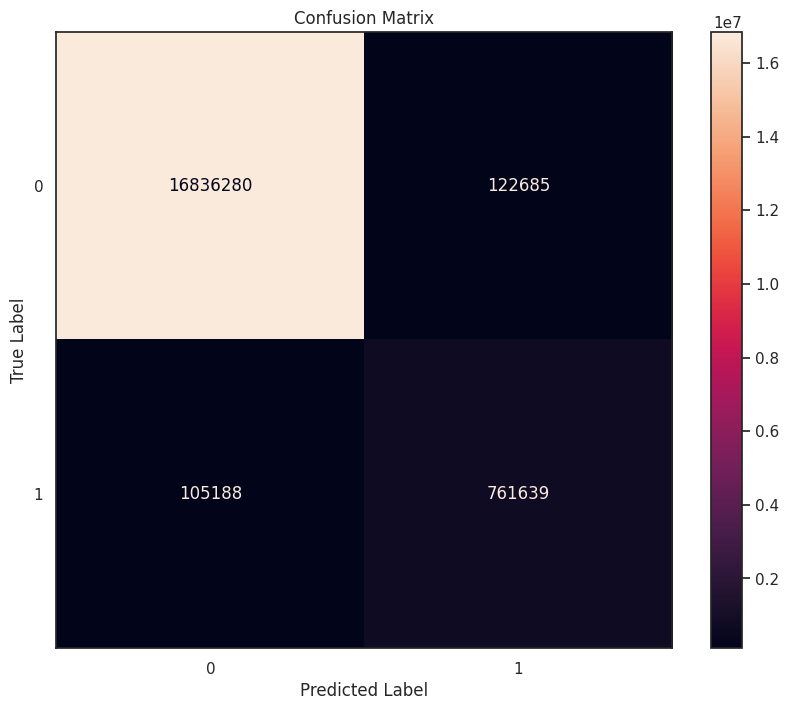

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

sns.set(style="white")
plt.figure(figsize=(10, 8))
class_labels = [0, 1]

disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=class_labels)
disp.plot(cmap="rocket", values_format=".0f", ax=plt.gca(), xticks_rotation='horizontal')

plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

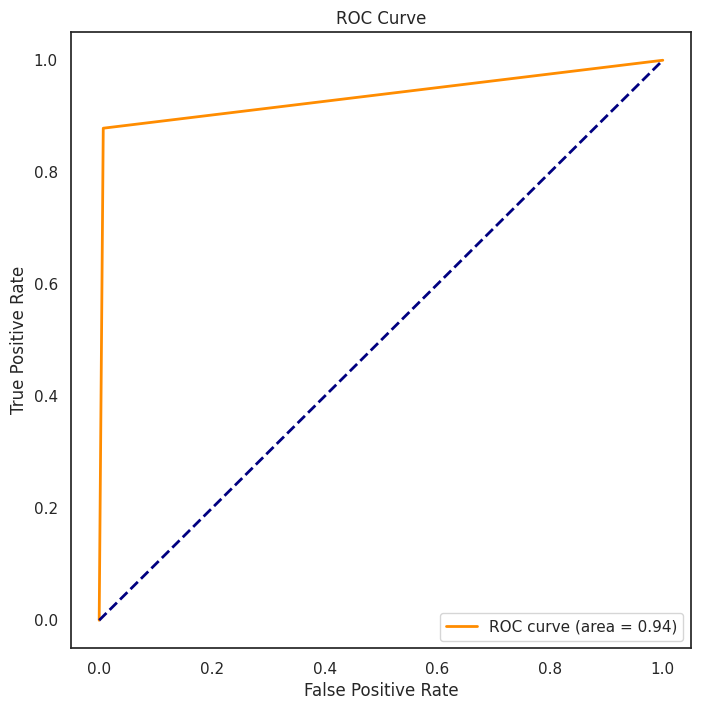

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
true_labels = np.array(true_labels)
pred_labels = np.array(pred_labels)

fpr, tpr, thresholds = roc_curve(true_labels, pred_labels)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')
plt.show()

[2.9565966e-02 1.1780951e-02 3.0222416e-04 ... 3.0923638e-07 3.8724019e-07
 3.8938982e-05]
(17825792,)
(17825792,)


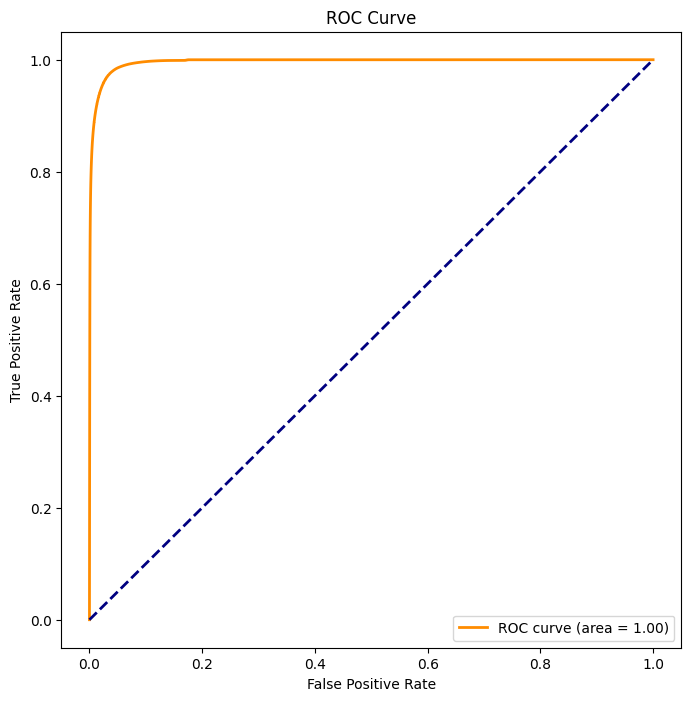

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

true_labels = np.array(true_labels)
#pred_labels = np.array(pred_labels)
pred_asfl = np.array(pred_asfl) # before binarization
print(pred_asfl)
fpr, tpr, thresholds = roc_curve(true_labels, pred_asfl)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc='lower right')

plt.show()

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(true_labels, pred_labels, digits=4))

              precision    recall  f1-score   support

           0     0.9938    0.9928    0.9933  16958965
           1     0.8613    0.8787    0.8699    866827

    accuracy                         0.9872  17825792
   macro avg     0.9275    0.9357    0.9316  17825792
weighted avg     0.9873    0.9872    0.9873  17825792



In [ ]:
#!pip install shap
#!pip install tf-keras-vis
#!pip install interpret

In [ ]:
from sklearn.metrics import matthews_corrcoef

mcc = matthews_corrcoef(true_labels, pred_labels)
print(f'Matthews Correlation Coefficient: {mcc}')

Matthews Correlation Coefficient: 0.8631989738597916


In [ ]:
from sklearn.metrics import fowlkes_mallows_score

fm_index = fowlkes_mallows_score(true_labels, pred_labels)
print(f'Fowlkes-Mallows Index: {fm_index}')

Fowlkes-Mallows Index: 0.9860802470307254


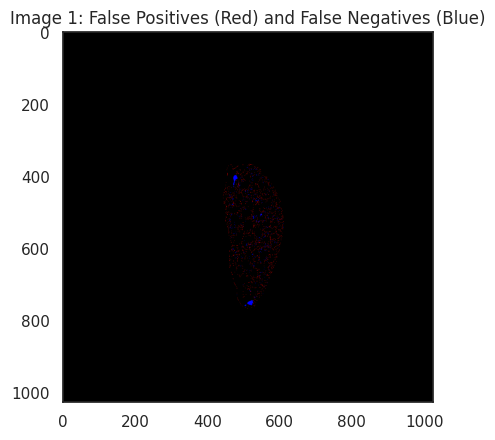

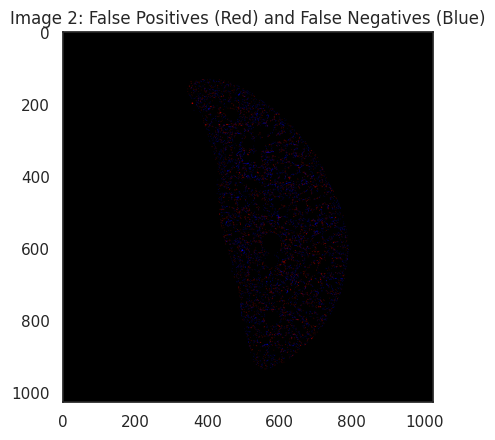

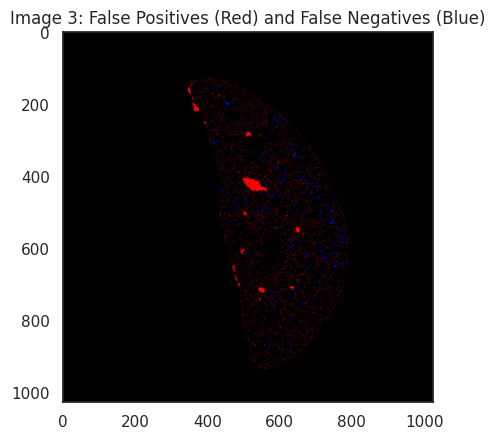

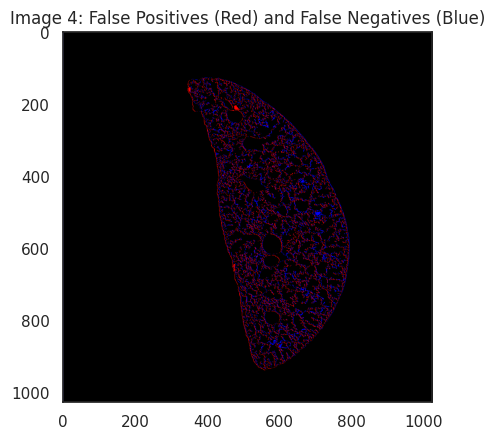

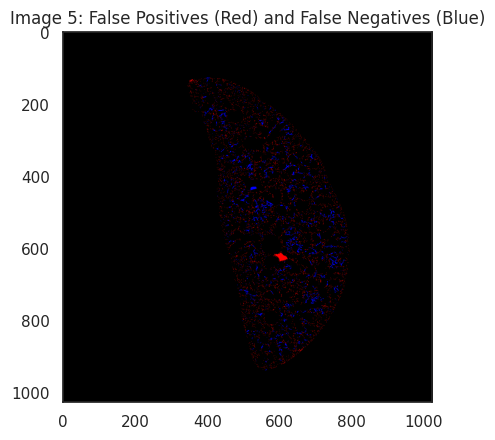

...

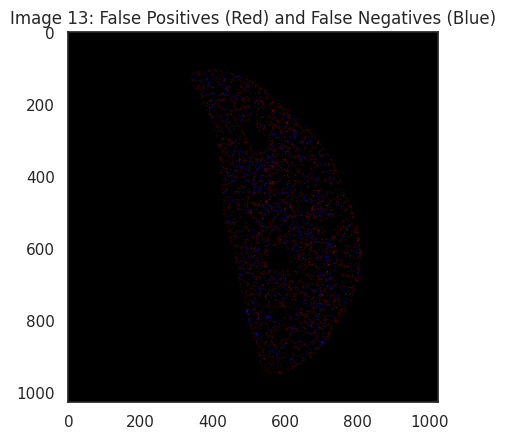

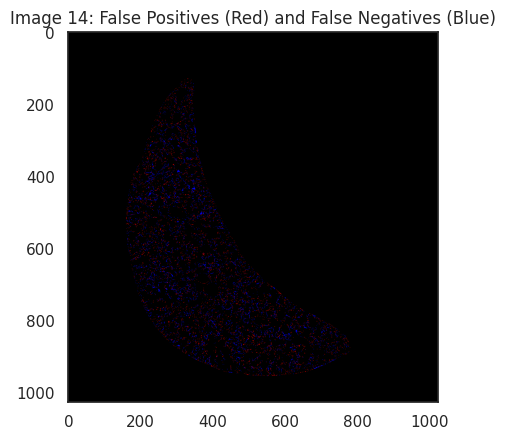

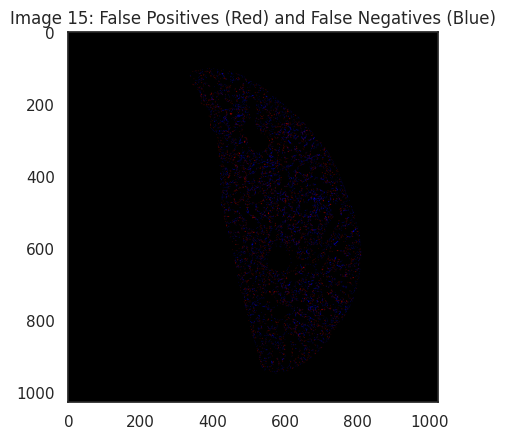

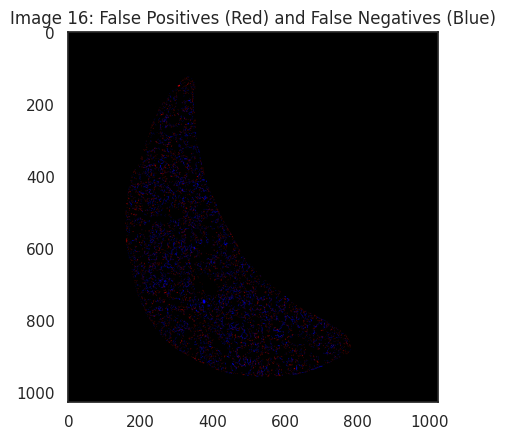

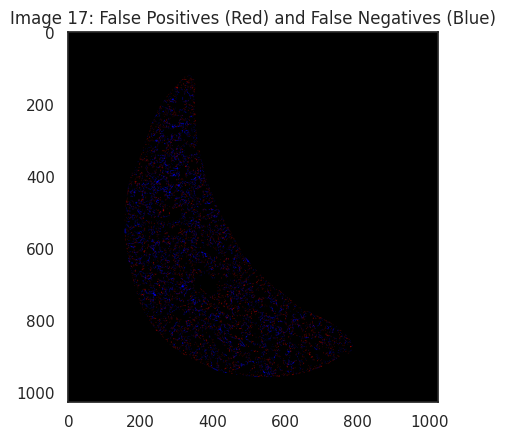

In [ ]:
def visualize_mask_differences(val_images, val_masks, model): #copypasta hehe
    num_images = len(images)

    for i in range(num_images):
        input_image = images[i]
        true_mask = masks[i]

        predicted_mask = model(np.expand_dims(input_image, axis=0))[0].numpy()
        predicted_mask = tf.squeeze(predicted_mask, axis=-1)

        false_positive = np.logical_and(predicted_mask > 0.5, true_mask <= 0.5)
        false_negative = np.logical_and(predicted_mask <= 0.5, true_mask > 0.5)

        composite_image = np.zeros_like(input_image, dtype=np.uint8)
        composite_image = np.stack([composite_image, composite_image, composite_image], axis=-1)

        composite_image[false_positive] = [255,0,0]  # Set red channel to 255 for false positives (model 1 ja 0)
        composite_image[false_negative] = [0,0,255]  # Set blue channel to 255 for false negatives (obr.)

        plt.imshow(composite_image)
        plt.title(f'Image {i + 1}: False Positives (Red) and False Negatives (Blue)')
        plt.show()

visualize_mask_differences(val_images, val_masks, model)